<a href="https://colab.research.google.com/github/Daniel-tns/MVP2/blob/main/MVP_2_Machine_Learning_e_Analytics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**MVP Sprint II: Machine Learning e Analytics**

## **Parte A - Modelo de Classificação**

###**1.Definição do Problema**

Esta etapa do MVP é realizada utilizando o dataset aplicado no MVP 1 - Análise de Dados e Boas Práticas, concluíndo a construção do modelo de classifcação.

O dataset utilizado neste MVP é o **Credit Card Churn Prediction**, proveniente do Kaggle e que pode ser acessado através do link https://www.kaggle.com/datasets/anwarsan/credit-card-bank-churn.

O objetivo deste dataset é entender quais aspectos podem ser mais relavantes para explicar o problema da perda de clientes, que deixam de utilizar o cartão de crédito do banco emissor e transferem seus negócios para a concorrência, contribuir para a previsão de quais clientes podem vir a migrar os gastos realizados em seu cartão de crédito para a outra insituição financeira. Este dataset possui diversos atributos relacionados à utilização de cartão de crédito pelos clientes da banco emissor e informações cadastrais como idade, gênero, número de dependentes, nível de escolaridade e estado cívil. Na base dados há a identificação do cliente "churn", que deixou de utilizar o cartão de crédito da instituição financiera, e do cliente "não churn", que permanece utilizando cartao de crédito e fazendo negócios com  banco. A classificação do cliente está informada no atributo "Attrition_Flag", com a marcação de "Existing Customer" para os clientes "não churn" e "Attrited Customer" para os clientes "churn". Este atributo terá sua nomeclatura alterada para "Churn".

Trata-se então de um problema de aprendizado supervisionado de Classificação, com os dados previamente rotulados para identificação dos clientes classificados como "churn".

Uma das hipóteses possíveis é que atributos como quantidade de produtos que o cliente consome ou mantêm no banco, seu limite de crédito, a quantidade de contato realizados pelo banco com o cliente nos últimos meses e tempo de relacionamento mantido com a instituição financeira possam ser relevantes para que o cliente permaneça fiel a instituição atual e seja mais resistentes a ofertas e campanhas de marketing de prospecção efetuadas bancos concorrentes. A confirmação da hipótese pode auxiliar as empresas do setor a preverem de forma antecipada quais clientes são passiveis de encerrar seus negócios com o banco e promoverem de forma ativa campanhas de retenção de clientes, aumentando a lucratividade e evitando gastos desnecessários com campanhas sem direcionamento.

As duas últimas colunas do dataset serão excluídas ao importar o arquivo por não trazerem informações sobre os clientes e por sugestão do colobarador que disponibilizou o dataset no Kaggle.

Os atributos do dataset serão renomeados a fim de facilitar a análise e são definidos conforme abaixo:

**Informações sobre os atributos:**

1. **CLIENTNUM -> "ID_Cliente":** Identificador único do cliente titular da cartão de crédito.
2. **Attrition_Flag -> "Churn":** Classificação do cliente em "churn" (Attrited Customer) e "não churn" (Existing Customer). Os termos serão substituídos por 1 e 0 para identificação do cliente "churn" e "não churn", respectivamente.
3. **Customer_Age -> "Idade":** Idade do cliente em anos.
4. **Gender -> "Genero":** Gênero do cliente, sendo M = Masculino e F = Feminino.
5. **Dependent_count -> "Numero_dependentes":** Número de dependentes cadastrados para o cliente.
6. **Education_Level -> "Escolaridade":** Nível de escolaridade do cliente, contendo os seguintes valores: College (Universitário), Doctorate (Doutorado), Graduate (pós-graduado), High School (Ensino médio), Post-Graduate (Pós-graduado), Uneducated (sem instrução) e Unknown (desconhecido).
7. **Marital_Status -> "Estado_civil":** Estado cívil do cliente, contendo os seguintes valores: Married (Casado), Single (Solteiro), Divorced (Divorciado) e Unknown (Desconhecido).
8. **Income_Category - > "Categoria_Renda":** Categoria de Renda Anual do cliente titular do cartão, contendo os seguintes grupos: less than $40k, $40k - $60k, $60k - $80k, $80k - $120k, $120k +, Unknown (Desconhecido).
9. **Card_Category -> "Categoria_Cartao":** Tipo de cartão utilizado pelo cliente, contendo os seguintes valores: Blue, Gold, Platinum e Silver.
10. **Months_on_book -> "Tempo_relacionamento":** Tempo de relacionamento com o banco em meses.
11. **Total_Relationship_Count -> "Quantidade_produtos":** Quantidade total de produtos que o cliente possui com o banco.
12. **Months_Inactive_12_mon -> "Qtd_meses_inativo_12m":** Quantidade de meses de inativaidade do cliente nos últimos 12 meses.
13. **Contacts_Count_12_mon -> "Qtd_contatos_12m":** Quantidade de contatos realizado pelo banco com o cliente nos últimos 12 meses.
14. **Credit_Limit -> "Limite_credito":** Limite de crédito do cliente em $.
15. **Total_Revolving_Bal -> "Saldo_rotativo_cartao":** Saldo rotativo total do cartão de crédito do cliente.
16. **Avg_Open_To_Buy -> "Media_limite_credito_disponivel_12m":** Valor médio de limite de crédito disponível para compras pelo cliente nos últimos 12 meses em moeda.
17. **Total_Amt_Chng_Q4_Q1 -> "Variacao_valor_transacao_Q4_Q1":** variação no valor total das transações realizadas pelo cliente no 4º Trimestre (Q4) em comparação com o 1º Trimeste (Q1), em percentual.
18. **Total_Trans_Amt -> "Valor_total_transacoes_12m":** Valor total das transações realizadas pelo cliente nos últimos 12 meses, em moeda.
19. **Total_Trans_Ct -> "Qtd_total_transacoes_12m":** Quantidade total de transações realizadas pelo cliente nos últimos 12 meses.
20. **Total_Ct_Chng_Q4_Q1 -> "Variacao_total_transacoes_Q4_Q1":** Variação na quantidade total de transações realizadas pelo cliente no 4º Trimestre (Q4) em comparação com o 1º Trimestre (Q1), em percentual.
21. **Avg_Utilization_Ratio -> "Taxa_media_uso_cartao":** Taxa média de utilização do cartão pelo cliente.


### **2.Importação do dados de um repositório no Github**

Importando as bibliotecas necessárias para análise e pré-processamento dos dados.

In [ ]:
# Importando as bibliotecas utilizadas
import warnings
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib.patches import Patch, Polygon
from matplotlib.lines import Line2D
import matplotlib.ticker as mtick
import seaborn as sns
import missingno as ms # para tratamento de missings
from pandas import set_option
from pandas.plotting import scatter_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import OrdinalEncoder # ordinal encoding
from sklearn.preprocessing import OneHotEncoder # one-hot encoding e dummy encoding
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.feature_selection import SelectKBest # para a Seleção Univariada
from sklearn.feature_selection import f_classif # para o teste ANOVA da Seleção Univariada
from sklearn.feature_selection import RFE # para a Eliminação Recursiva de Atributos
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.metrics import confusion_matrix
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import VotingClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier

from IPython.display import display, Markdown

Importação do arquivo credit_card_churn.csv disponível no repositório do Github.

In [ ]:
# Carregando o arquivo csv usando Pandas informando uma URL

# Informa a URL de importação do dataset no Github
url = "https://raw.githubusercontent.com/Daniel-tns/MVP/main/credit_card_churn.csv"

# Informa o cabeçalho das colunas
colunas = ['ID_Cliente', 'Churn', 'Idade', 'Genero', 'Numero_dependentes', 'Escolaridade', 'Estado_civil', 'Categoria_Renda', 'Categoria_Cartao',
           'Tempo_relacionamento', 'Quantidade_produtos', 'Qtd_meses_inativo_12m', 'Qtd_contatos_12m', 'Limite_credito', 'Saldo_rotativo_cartao',
           'Media_limite_credito_disponivel_12m', 'Variacao_valor_transacao_Q4_Q1','Valor_total_transacoes_12m', 'Qtd_total_transacoes_12m',
           'Variacao_total_transacoes_Q4_Q1', 'Taxa_media_uso_cartao',
           'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1',
           'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2']

# Realiza a leitura do arquivo utilizando as colunas informadas
dataset = pd.read_csv(url, names = colunas, skiprows = 1, delimiter = ',')

# As 2 ultimas colunas do dataset devem ser desconsideradas por recomendação do construtor por não trazerem informações relacionadas aos clientes.

# Exluindo as 2 ultimas colunas do dataset e atribuindo a um novo dataframe
clientes = dataset.drop(['Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1',
                         'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2'],
                          axis = 1)

In [ ]:
# Verificando as 5 primeiras linhas do dataset
clientes.head()

,ID_Cliente,Churn,Idade,Genero,Numero_dependentes,Escolaridade,Estado_civil,Categoria_Renda,Categoria_Cartao,Tempo_relacionamento,...,Qtd_meses_inativo_12m,Qtd_contatos_12m,Limite_credito,Saldo_rotativo_cartao,Media_limite_credito_disponivel_12m,Variacao_valor_transacao_Q4_Q1,Valor_total_transacoes_12m,Qtd_total_transacoes_12m,Variacao_total_transacoes_Q4_Q1,Taxa_media_uso_cartao
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,...,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,...,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,...,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000


Alteração da ordenação das colunas para que a coluna alvo **"Churn"** seja a última coluna do dataset, facilitando a sua identificação.

In [ ]:
# Alterando a ordem das colunas para que a coluna "Churn" fique na última posição do dataset
clientes = clientes[['ID_Cliente',
                     'Idade',
                     'Genero',
                     'Numero_dependentes',
                     'Escolaridade',
                     'Estado_civil',
                     'Categoria_Renda',
                     'Categoria_Cartao',
                     'Tempo_relacionamento',
                     'Quantidade_produtos',
                     'Qtd_meses_inativo_12m',
                     'Qtd_contatos_12m',
                     'Limite_credito',
                     'Saldo_rotativo_cartao',
                     'Media_limite_credito_disponivel_12m',
                     'Variacao_valor_transacao_Q4_Q1',
                     'Valor_total_transacoes_12m',
                     'Qtd_total_transacoes_12m',
                     'Variacao_total_transacoes_Q4_Q1',
                     'Taxa_media_uso_cartao',
                     'Churn'
                     ]]

# Exibindo as 5 primeiras linhas do dataset para confirmar nova ordenação das colunas
clientes.head()

,ID_Cliente,Idade,Genero,Numero_dependentes,Escolaridade,Estado_civil,Categoria_Renda,Categoria_Cartao,Tempo_relacionamento,Quantidade_produtos,...,Qtd_contatos_12m,Limite_credito,Saldo_rotativo_cartao,Media_limite_credito_disponivel_12m,Variacao_valor_transacao_Q4_Q1,Valor_total_transacoes_12m,Qtd_total_transacoes_12m,Variacao_total_transacoes_Q4_Q1,Taxa_media_uso_cartao,Churn
0,768805383,45,M,3,High School,Married,$60K - $80K,Blue,39,5,...,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,Existing Customer
1,818770008,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,...,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,Existing Customer
2,713982108,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,...,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,Existing Customer
3,769911858,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,...,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,Existing Customer
4,709106358,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,...,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,Existing Customer


Substituição dos termos **"Attrited Customer"** e **"Existing Customer"** na coluna **"Churn"** pelos números 1 e 0, respectivamente, em formato texto para facilitar a análise e utilização nos modelos de ML.


In [ ]:
# Substituindo os termos "Attrited Customer" pela string "1" e "Existing Customer" pela string "0" na coluna "Churn"
clientes['Churn'] = clientes['Churn'].replace(["Attrited Customer", "Existing Customer"], ["1", "0"])

# Exbindo uma amostra da coluna "Churn" do dataset clientes para confirmar a substituição das strings
print(clientes['Churn'].sample(5))

2048    0
5094    0
2764    0
9378    0
5054    0
Name: Churn, dtype: object


### **3.Análise de Dados**

####3.1 Estatísitcas Descritivas

Verificando a quantidade total de atributos e instâncias do dataset **"clientes"**.

O dataset é composto por 10.127 linhas e 21 atributos.

In [ ]:
# Verificanto as dimensões do dataset
print(clientes.shape)

(10127, 21)


In [ ]:
# Exibindo as 5 primeiras linhas do dataset
clientes.head()

,ID_Cliente,Idade,Genero,Numero_dependentes,Escolaridade,Estado_civil,Categoria_Renda,Categoria_Cartao,Tempo_relacionamento,Quantidade_produtos,...,Qtd_contatos_12m,Limite_credito,Saldo_rotativo_cartao,Media_limite_credito_disponivel_12m,Variacao_valor_transacao_Q4_Q1,Valor_total_transacoes_12m,Qtd_total_transacoes_12m,Variacao_total_transacoes_Q4_Q1,Taxa_media_uso_cartao,Churn
0,768805383,45,M,3,High School,Married,$60K - $80K,Blue,39,5,...,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0
1,818770008,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,...,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0
2,713982108,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,...,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0
3,769911858,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,...,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0
4,709106358,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,...,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0


In [ ]:
# Exibindo as 5 últimas linhas do dataset
clientes.tail()

,ID_Cliente,Idade,Genero,Numero_dependentes,Escolaridade,Estado_civil,Categoria_Renda,Categoria_Cartao,Tempo_relacionamento,Quantidade_produtos,...,Qtd_contatos_12m,Limite_credito,Saldo_rotativo_cartao,Media_limite_credito_disponivel_12m,Variacao_valor_transacao_Q4_Q1,Valor_total_transacoes_12m,Qtd_total_transacoes_12m,Variacao_total_transacoes_Q4_Q1,Taxa_media_uso_cartao,Churn
10122,772366833,50,M,2,Graduate,Single,$40K - $60K,Blue,40,3,...,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462,0
10123,710638233,41,M,2,Unknown,Divorced,$40K - $60K,Blue,25,4,...,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511,1
10124,716506083,44,F,1,High School,Married,Less than $40K,Blue,36,5,...,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000,1
10125,717406983,30,M,2,Graduate,Unknown,$40K - $60K,Blue,36,4,...,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000,1
10126,714337233,43,F,2,Graduate,Married,Less than $40K,Silver,25,6,...,4,10388.0,1961,8427.0,0.703,10294,61,0.649,0.189,1


In [ ]:
# Mostrando as informações do dataset
print(clientes.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 21 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   ID_Cliente                           10127 non-null  int64  
 1   Idade                                10127 non-null  int64  
 2   Genero                               10127 non-null  object 
 3   Numero_dependentes                   10127 non-null  int64  
 4   Escolaridade                         10127 non-null  object 
 5   Estado_civil                         10127 non-null  object 
 6   Categoria_Renda                      10127 non-null  object 
 7   Categoria_Cartao                     10127 non-null  object 
 8   Tempo_relacionamento                 10127 non-null  int64  
 9   Quantidade_produtos                  10127 non-null  int64  
 10  Qtd_meses_inativo_12m                10127 non-null  int64  
 11  Qtd_contatos_12m            

In [ ]:
# Verificando a quantidade de atributos categóricos e numéricos no dataset utilizado
variaveis_categoricas = [var for var in clientes.columns
                        if clientes[var].dtype == 'object' and var != 'Churn']

variaveis_numericas = [var for var in clientes.columns
                      if clientes[var].dtype != 'object']

print("Número de atributos categóricos: {}".format(len(variaveis_categoricas)))
print("Número de atributos numéricos: {} (incluindo o atributo ID_Cliente)".format(len(variaveis_numericas)))

Número de atributos categóricos: 5
Número de atributos numéricos: 15 (incluindo o atributo ID_Cliente)


O dataset utilizado possui os seguintes tipos de varíaveis disponíveis:

*   **Qualitativas Ordinais:** Escolaridade, Categoria_Renda, Categoria_Cartao.
*   **Qualitativas Nominais:** Genero, Estado_civil, Churn.
*   **Quantitativas Discretas:** Numero_dependentes, Tempo_relacionamento, Quantidade_produtos, Qtd_meses_inativo_12m, Qtd_contatos_12m, Qtd_total_transacoes_12m.
*   **Quantitativas Contínuas:** Idade, Saldo_rotativo_cartao, Valor_total_transacoes_12m, Limite_credito, Media_limite_credito_disponivel_12m, Variacao_valor_transacao_Q4_Q1, Variacao_total_transacoes_Q4_Q1, Taxa_media_uso_cartao.

In [ ]:
# Resumo estatístico do dataset clientes, excluíndo a coluna "ID_Cliente"
clientes.drop('ID_Cliente', axis = 1).describe().T

,count,mean,std,min,25%,50%,75%,max
Idade,10127.0,46.325960,8.016814,26.0,41.000,46.000,52.000,73.000
Numero_dependentes,10127.0,2.346203,1.298908,0.0,1.000,2.000,3.000,5.000
Tempo_relacionamento,10127.0,35.928409,7.986416,13.0,31.000,36.000,40.000,56.000
Quantidade_produtos,10127.0,3.812580,1.554408,1.0,3.000,4.000,5.000,6.000
Qtd_meses_inativo_12m,10127.0,2.341167,1.010622,0.0,2.000,2.000,3.000,6.000
Qtd_contatos_12m,10127.0,2.455317,1.106225,0.0,2.000,2.000,3.000,6.000
Limite_credito,10127.0,8631.953698,9088.776650,1438.3,2555.000,4549.000,11067.500,34516.000
Saldo_rotativo_cartao,10127.0,1162.814061,814.987335,0.0,359.000,1276.000,1784.000,2517.000
Media_limite_credito_disponivel_12m,10127.0,7469.139637,9090.685324,3.0,1324.500,3474.000,9859.000,34516.000
Variacao_valor_transacao_Q4_Q1,10127.0,0.759941,0.219207,0.0,0.631,0.736,0.859,3.397


**Exibindo o resumo estatístico dos atributos númericos do dataset.**

Podemos observar, por exemplo, que as idades dos clientes variam entre 26 e 73 anos, o tempo de relacionamento com o banco é de no mínimo 13 meses e de no máximo 56 meses e que metade dos clientes possui até 4 produtos com o banco.

É preciso verificar a distribuição do atributo Qtd_contatos_12m, que quantifica a quantidade de contatos realizados pelo banco com o cliente nos últimos 12 meses, uma vez que há clientes sem contato na base de dados e isto pode ser um fator importante para o encerramento do relacionamento e da utilização do cartão de crédito.

Também podemos verificar que há clientes na base dados com metade do tempo de observação (12 meses) sem utilização do cartão de crédito, fator que pode ser relevante também para o fenômeno do churn.

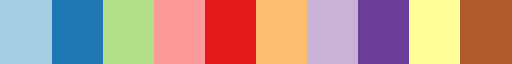

['#a6cee3',
 '#1f78b4',
 '#b2df8a',
 '#fb9a99',
 '#e31a1c',
 '#fdbf6f',
 '#cab2d6',
 '#6a3d9a',
 '#ffff99',
 '#b15928']

In [ ]:
# Selecionando uma paleta de cores da biblioteca Matplotlib para utilização nos gráficos produzidos

# Definindo paleta de cores para os gráficos

# Utilizando a paleta de cores viridis
vcmap = plt.get_cmap("Paired", 10)

# Exibindo o mapa de cores
display(vcmap)

# Convertendo o mapa de cores em um vetor para uso de cores indiviuais
coresPaired = [mpl.colors.rgb2hex(vcmap(i)) for i in range(10)] # extrai lista de cores em hex
display(coresPaired)

# Definindo uma cor default
corDefault = coresPaired[1]

# Definindo uma lisa de cores
cores = ['#a6cee3', '#1f78b4', '#b2df8a', '#fb9a99', '#e31a1c', '#fdbf6f', '#cab2d6', '#6a3d9a', '#ffff99', '#b15928']

Identificando se há desbalanceamento das classes na base de dados utilizada.

Churn
0    8500
1    1627
dtype: int64


0    83.934038
1    16.065962
Name: Churn, dtype: float64


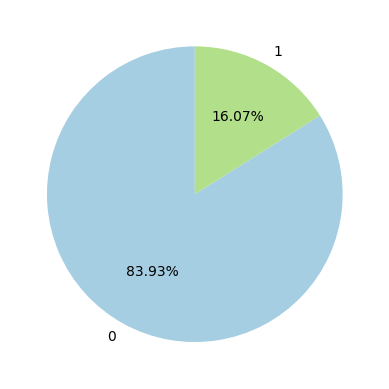

In [ ]:
# Verificando se há desblanceamento de classes

# Quantificando a quantidade de clientes "churn" e "não churn"
print(clientes.groupby('Churn').size())
print("\n")

# Exibindo o percentual de clientes "churn" e "não churn"
print(clientes['Churn'].value_counts() / len(clientes['Churn']) * 100)

# Plotando um gráfico de pizza com a distribuição dos clientes "churn" e "não churn"
fig, ax = plt.subplots()
labels = clientes['Churn'].unique()
ax.pie(clientes.groupby('Churn').size(), colors = ('#a6cee3','#b2df8a'), labels = labels, autopct = '%1.2f%%', startangle = 90)
plt.show()

Podemos observar que os clientes classificados como "churn" correspondem à 16,07% do total de clientes análisados e que a base de dados utilizada está desbalanceada.

####3.2 Visualizações Unimodais

Analisando os atributos númericos do dataset através da criação de histogramas.

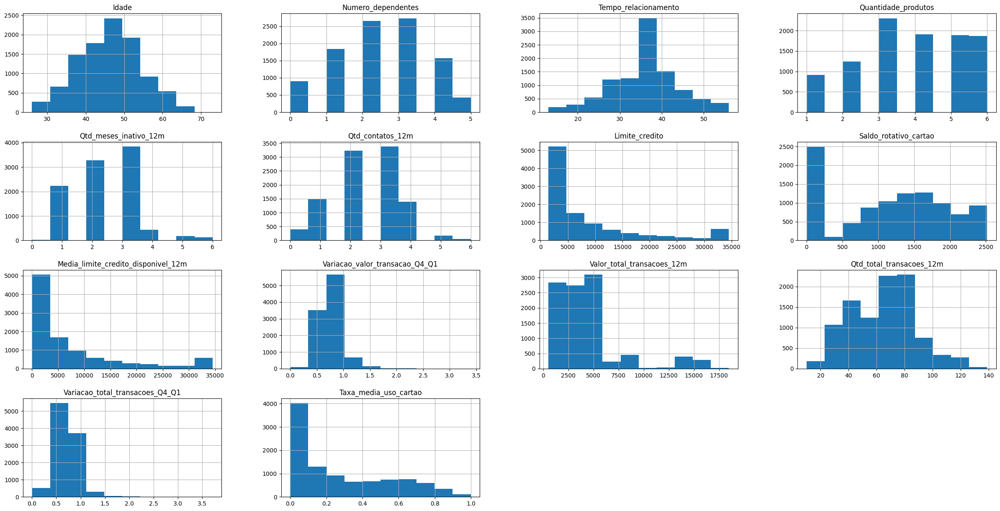

In [ ]:
# Criando um histograma para cada atributo do dataset

# Histograma
clientes.drop('ID_Cliente', axis = 1).hist(figsize = (30, 15)) # Excluindo a coluna "ID-Cliente" da exibição dos gráficos de Histograma
plt.show()

Analisando os histogramas de cada um dos atributos numéricos do dataset é possivel observar que os atributos Idade, Numero_dependentes, Tempo_relacionamento, Variacao_total_transações_Q4_Q1, Qtd_total_transacoes_12m e Variacao_valor_transacao_Q4_Q1 parecem seguir uma distribuição aproximadamente normal.

Os atributos Limite_Credito, Media_limite_credito_disponivel_12m, Valor_total_transacoes_12m e Taxa_media_uso_cartao parecem seguir uma distribuição exponencial.

A maior parte dos clientes possui entre 30 e 60 anos de idade e metade da amostra possui 2 ou 3 dependentes. A maioria dos clientes têm tempo de relacionamento entre 30 e 40 meses e possui acima de 3 produtos contratados no banco.

Quase a totalidade dos clientes possui valor total de transações de até 6 mil e com quantidade total de transações nos últimos 12 meses variando entre 20 e 100 transações.

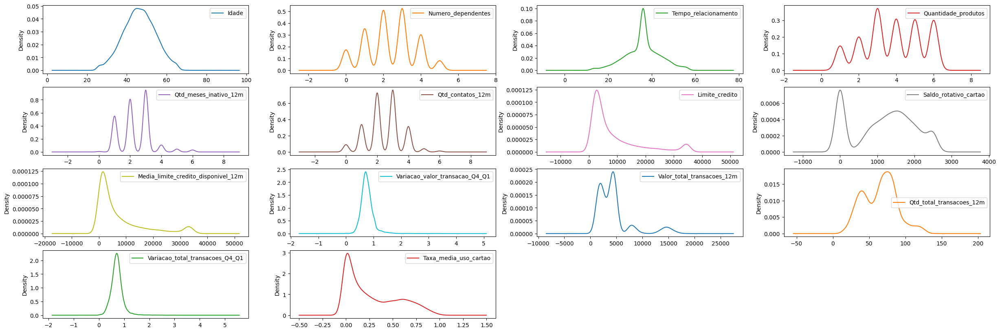

In [ ]:
# Criando um Density Plot de cada atributo do dataset

# Excluindo a coluna "ID-Cliente" da exibição dos gráficos de Densidade
clientes.drop('ID_Cliente', axis = 1).plot(kind = 'density', subplots = True, layout = (4, 4), sharex = False, figsize = (30, 10))
plt.show()

Identificando a presença de Outliers no conjunto de dados utilizados.

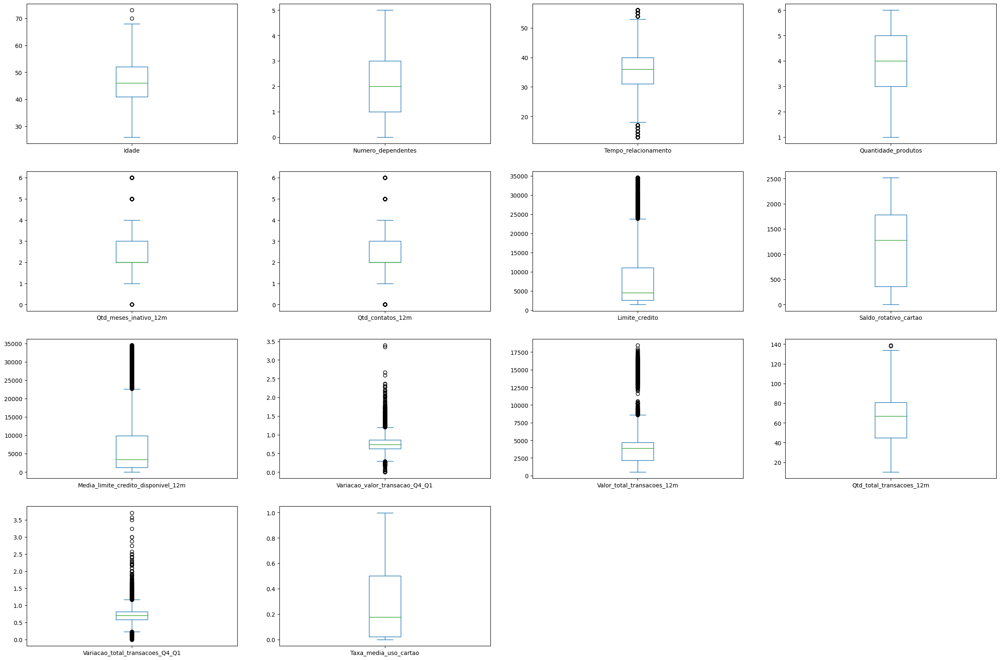

In [ ]:
# Verificando a existência de outliers utilizando gráficos Boxplot

# Excluindo a coluna "ID-Cliente" da exibição dos gráficos
clientes.drop('ID_Cliente', axis = 1).plot(kind = 'box', subplots = True, layout = (4, 4), sharex = False, sharey = False, figsize = (30, 20))
plt.show()

Podemos observar que os atributos Idade, Tempo_relacionamento, Qtd_meses_inativo_12m, Qtd_contatos_12m, Limite_credito, Media_limite_credito_disponivel_12m, Variacao_valor_transacao_Q4_Q1, Valor_total_transacoes_12m, Qtd_total_transacoes_12m e Variacao_total_transacoes_Q4_Q1 apresentam dados que podem ser considerados possíveis outliers, conforme os gráficos boxplots exibidos acima.

Para a exibição do percentual de clientes churn e não churn em cada subgrupo dos atributo categóricos disponíveis no dataset foi criada uma função para utilização nos gráficos produzidos a seguir.

In [ ]:
# Definindo uma função para exibir os rótulos das barras em percentual do total do atributo

def adiciona_rotulo_percentual(df, xVar, ax):

    """ Adiciona percentual correspondete como rótulo no gráfico de barras """

    # fonte:https://stackoverflow.com/a/67076347/4852724

    # Argumentos:
        # df: pandas dataframe
        # xVar: (string) variável X
        # ax: Axes object (para Seaborn Countplot/Bar plot ou pandas bar plot)

    # 1. Verificando a quantidade de Categorias (X)
    ## Checando se valores NaN e removendo
    numX = len([x for x in clientes[xVar].unique() if x == x])

    # 2. As barras são criadas em ordem de matiz (hue), sendo necessário organizá-las
    bars = ax.patches

    ## 2a. Para cada variável X
    for ind in range(numX):

        ## 2b. Obtendo todas as matizes das barras (hue bar)
        ##     ex: 8 categorias X, 4 matizes => [0, 8, 16, 24] são matizes das barras para a 1ª categoria X
        hueBars = bars[ind:][::numX]

        ## 2c. Obtendo a altura total (para porcentagens)
        total = sum([x.get_height() for x in hueBars])

        # 3. Printando as porcentagens nas barras
        for bar in hueBars:
            ax.text(bar.get_x() + bar.get_width()/2.,
                    bar.get_height(),
                    f'{bar.get_height()/total:.2%}',
                    ha = 'center', va = 'bottom', color = 'black')

Criando graficos dos atributos qualitativos para observação dos classes.

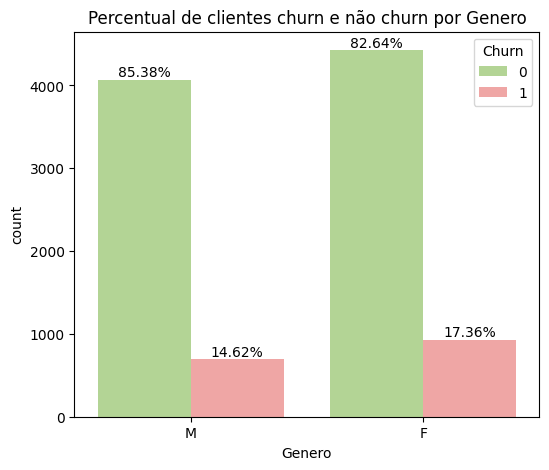

In [ ]:
# Plotando os gráficos de barras utilizando a biblioteca seaborn para análise da varíavel Gênero
atributo = 'Genero'
fig = plt.figure(figsize = (6, 5))
ax = sns.countplot(data = clientes, x = atributo, hue = 'Churn', palette = cores[2:4])

# Adiciona os rotulos de percentual nas barras indicando o percentual de clientes "churn" e "não churn"
adiciona_rotulo_percentual(clientes, atributo, ax )

# adiciona um título aos gráficos dos atributos
plt.title(f'Percentual de clientes churn e não churn por {atributo}')

# Exibe os gráficos
plt.show()

Em relação ao atributo Gênero, é possível observar que o percentual de clientes churn é ligeramente maior para o publico feminino (17,36%) do que para o público masculino (14,62%).

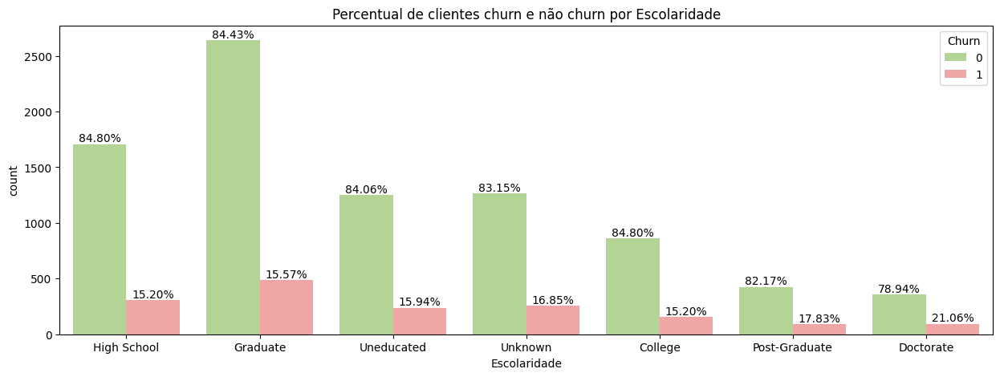

In [ ]:
# Plotando os gráficos de barras utilizando a biblioteca seaborn para análise da varíavel Escolaridade
atributo = 'Escolaridade'
fig = plt.figure(figsize = (15, 5))
ax = sns.countplot(data = clientes, x = atributo, hue = 'Churn', palette = cores[2:4])

# Adiciona os rotulos de percentual nas barras indicando o percentual de clientes "churn" e "não churn"
adiciona_rotulo_percentual(clientes, atributo, ax )

# adiciona um título aos gráficos dos atributos
plt.title(f'Percentual de clientes churn e não churn por {atributo}')

# Exibe os gráficos
plt.show()

Em relação ao nível de escolaridade dos clientes, é possível perceber que o percentual de clientes churn é maior em clientes com maior nível de escolaridade, como por exemplor nos clientes com nível Doctorate (21,06%) e Post-Graduate (17,83%), mas com percentual acima de 15% em todos os grupos deste atributo.

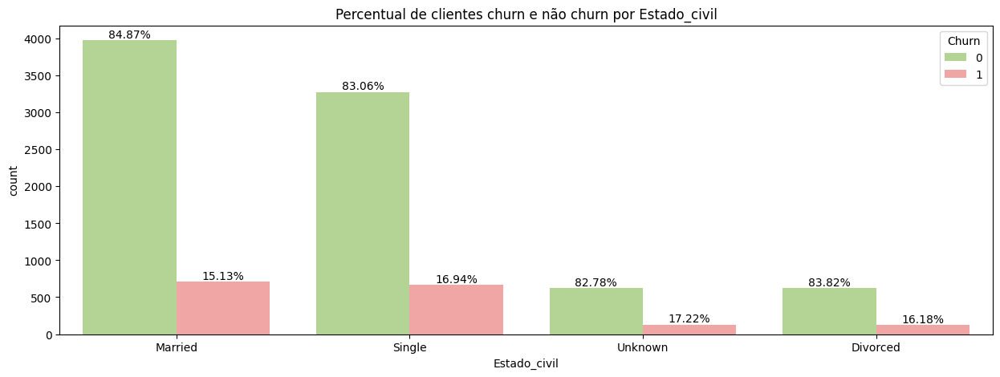

In [ ]:
# Plotando os gráficos de barras utilizando a biblioteca seaborn para análise da varíavel Estado Cívil
atributo = 'Estado_civil'
fig = plt.figure(figsize = (15, 5))
ax = sns.countplot(data = clientes, x = atributo, hue = 'Churn', palette = cores[2:4])

# Adiciona os rotulos de percentual nas barras indicando o percentual de clientes "churn" e "não churn"
adiciona_rotulo_percentual(clientes, atributo, ax )

# adiciona um título aos gráficos dos atributos
plt.title(f'Percentual de clientes churn e não churn por {atributo}')

# Exibe os gráficos
plt.show()

Em relação ao estado cívil dos clientes, observamos que o percentual de clientes churn é maior em clientes solteiros (16,94%) e com estado cívil não declarado (17,22%). Em todos os grupos o percentual de clientes churn foi superior a 15%.

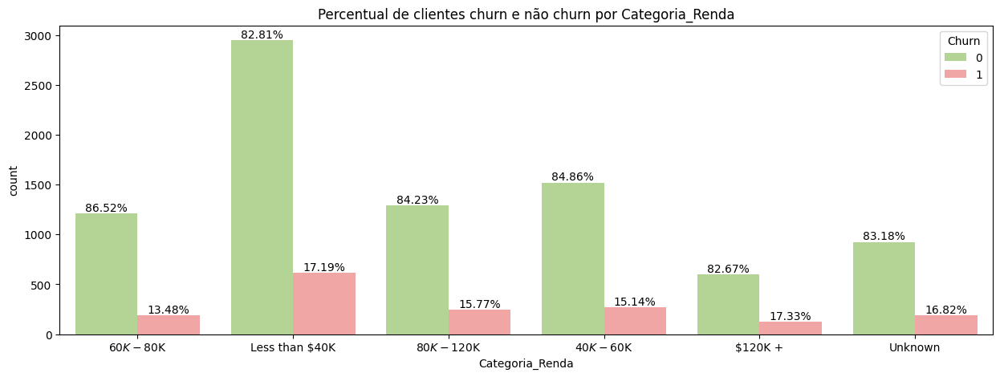

In [ ]:
# Plotando os gráficos de barras utilizando a biblioteca seaborn para análise da varíavel Categoria_Renda
atributo = 'Categoria_Renda'
fig = plt.figure(figsize = (15, 5))
ax = sns.countplot(data = clientes, x = atributo, hue = 'Churn', palette = cores[2:4])

# Adiciona os rotulos de percentual nas barras indicando o percentual de clientes "churn" e "não churn"
adiciona_rotulo_percentual(clientes, atributo, ax )

# adiciona um título aos gráficos dos atributos
plt.title(f'Percentual de clientes churn e não churn por {atributo}')

# Exibe os gráficos
plt.show()

Em relação à renda dos clientes pecebemos que os clientes com renda anual superior a 120 mil e inferior a 40 mil têm os maiores percentuais de churn (17,33% e 17,19%), respectivamente, e que a maior parte dos clientes está classificada como tendo renda inferior a 40 mil por ano.

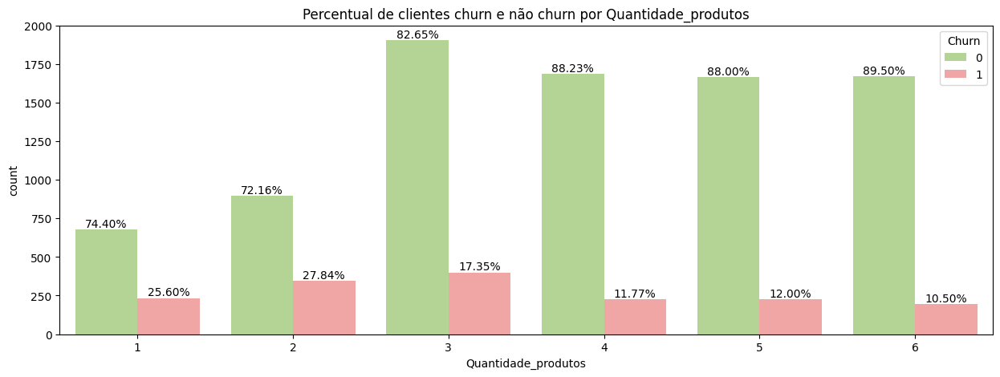

In [ ]:
# Plotando os gráficos de barras utilizando a biblioteca seaborn para análise da varíavel Quantidade_produtos
atributo = 'Quantidade_produtos'
fig = plt.figure(figsize = (15, 5))
ax = sns.countplot(data = clientes, x = atributo, hue = 'Churn', palette = cores[2:4])

# Adiciona os rotulos de percentual nas barras indicando o percentual de clientes "churn" e "não churn"
adiciona_rotulo_percentual(clientes, atributo, ax )

# adiciona um título aos gráficos dos atributos
plt.title(f'Percentual de clientes churn e não churn por {atributo}')

# Exibe os gráficos
plt.show()

Também podemos observar que a quantidade de produtos consumidos pelos clientes pode ter relação inversa com o percentual de clientes que deixam de utilizar o cartão de crédito do banco. Cliente que possuem até 2 produtos apenas tem percentual de churn acima de 25% enquanto que clientes que 4 ou mais produtos tem apenas 12% ou menos de clientes classificados como churn.

Este fator pode indicar que clientes com uma quantidade maior de produtos tem um nível maior de fidelidade ao banco ou que esta quantidade maior pode se mostrar como sendo um dificultaddor para o cliente na hora de tomar a decisão de encerrar seus negócios com a organização e de migrar para o concorrente.

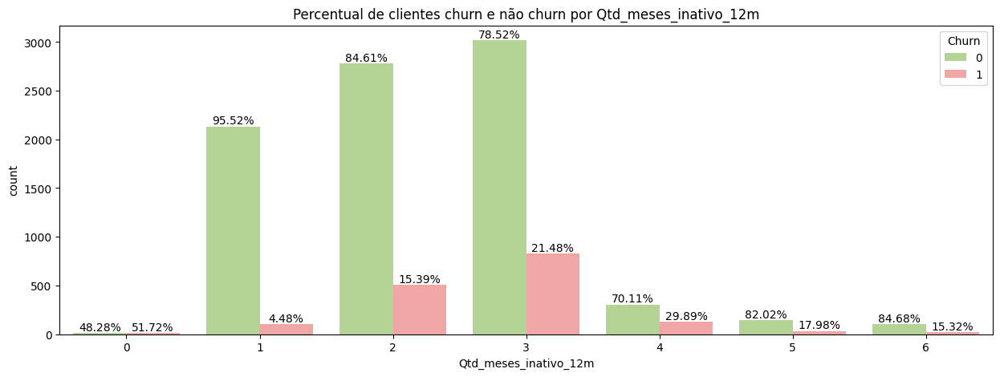

In [ ]:
# Plotando os gráficos de barras utilizando a biblioteca seaborn para análise da varíavel Qtd_meses_inativo_12m
atributo = 'Qtd_meses_inativo_12m'
fig = plt.figure(figsize = (15, 5))
ax = sns.countplot(data = clientes, x = atributo, hue = 'Churn', palette = cores[2:4])

# Adiciona os rotulos de percentual nas barras indicando o percentual de clientes "churn" e "não churn"
adiciona_rotulo_percentual(clientes, atributo, ax )

# adiciona um título aos gráficos dos atributos
plt.title(f'Percentual de clientes churn e não churn por {atributo}')

# Exibe os gráficos
plt.show()

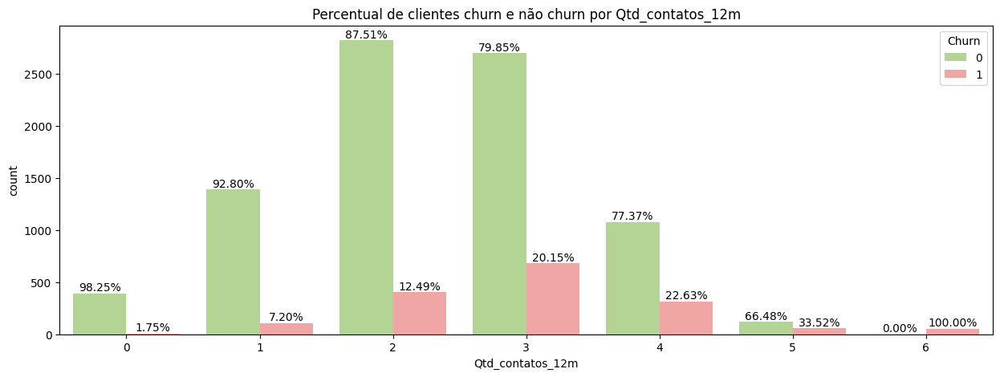

In [ ]:
# Plotando os gráficos de barras utilizando a biblioteca seaborn para análise da varíavel Qtd_contatos_12m
atributo = 'Qtd_contatos_12m'
fig = plt.figure(figsize = (15, 5))
ax = sns.countplot(data = clientes, x = atributo, hue = 'Churn', palette = cores[2:4])

# Adiciona os rotulos de percentual nas barras indicando o percentual de clientes "churn" e "não churn"
adiciona_rotulo_percentual(clientes, atributo, ax )

# adiciona um título aos gráficos dos atributos
plt.title(f'Percentual de clientes churn e não churn por {atributo}')

# Exibe os gráficos
plt.show()

Em relação a quantidade de meses de inatividade nos últimos 12 meses e quantidades de contatos recebidos nos ultimos 12 meses não ficam claras as relações entre o tempo de inatividade com a iniciativa do cliente de deixar de fazer negócios com o banco, uma vez que o maior percentual de churn está localizado em clientes com 3 meses de inatividade (21,48%) e não com 6 meses (15,32%) como poderia ser esperado, e entre a quantidade de contatos realizados com o cliente nos últimos 12 meses e o percentual de churn, já que clientes que apresentaram maior quantidade de contatos, 4 ou 5 contatos nos últimos 12 meses, apresentaram também maior percentual de churn (22,63% e 33,52%).

####3.3.Visualizações Multimodais

Analisando a correlação das atributos disponíveis no dataset clientes.

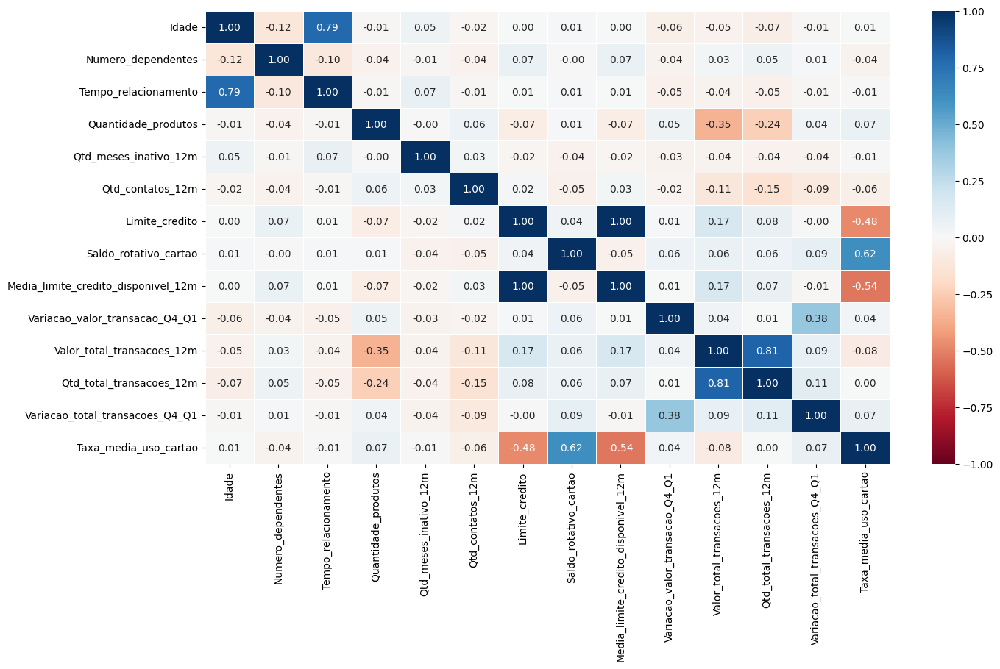

In [ ]:
# Matriz de Correlação com Matplotlib Seaborn
# Excluindo a coluna "ID-Cliente" da Matriz de Correlação
plt.figure(figsize = (15, 8))
sns.heatmap(clientes.drop('ID_Cliente', axis = 1).corr(), annot = True, cmap = 'RdBu', fmt = ".2f", linewidth =.5, xticklabels = "auto", yticklabels = "auto", vmin = -1, vmax = 1);

Em relação a Matriz de Correlação, podemos observar que as variávies abaixo estão positivamente correlacionadas, apresentando correlação positiva acima de 0,5:

*   Tempo de Relacionamento e Idade: **0,79**
*   Média de Limite de Crédito Disponível nos Últimos 12 Meses e Limite de Crédito: **1,00**
*   Saldo Rotativo no Cartão e Taxa Média de Utilização do Cartão: **0,62**
*   Valor Total das Transações nos Últimos 12 Meses e Quantidade Total de Transações nos Últimos 12 Meses: **0,81**

As variáveis Média de Limite de Crédito Disponível nos Últimos 12 Meses e Taxa Média de Uso do Cartão apresentaram uma correlação negativa significativa de **-0,54**.

Para verificar o relacionamento entre pares de atributos do dataset vamos utilizar o gráfico scatter plot da biblioteca Seaborn.

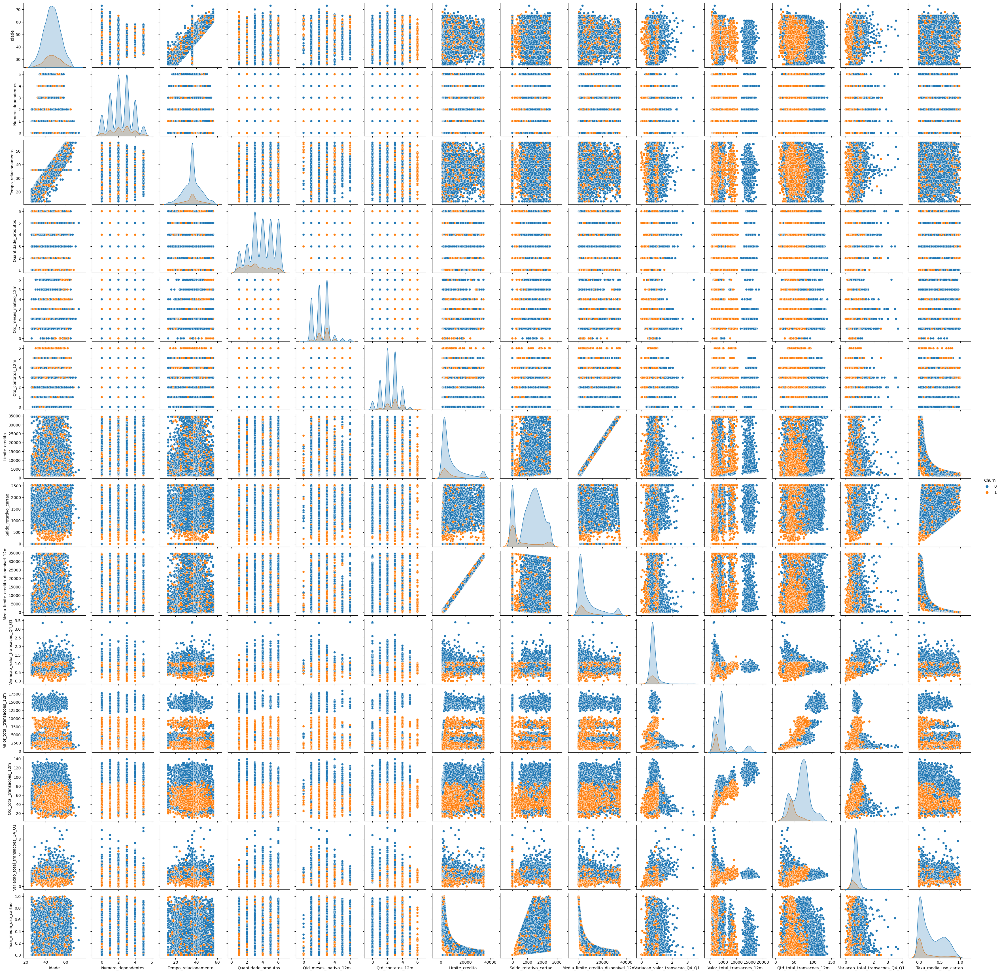

In [ ]:
# Utilizando Grafícos de Dispersão para mostrar o relacionamento entre as variávies do dataset
sns.pairplot(clientes.drop('ID_Cliente', axis = 1), hue = "Churn", height = 2.5)

Utilizando o gráfico de dispersão é possível perceber relações positivas entre as variávies Idade e Tempo de relacionamento, entre Limite de crédito e Média limite de crédito disponível e entre Quantidade total de transações nos últimos 12 meses e Valor total das transações nos últimos 12 meses.

Alguns atributos apresentam divisões de classes bem definidadas quando utilizamos a classificação de churn ou não churn na visualização das relações entre variávies.

Os atributos Valor_total_transacoes_12m, Qtd_total_transacoes_12m e Variacao_total_transacoes_Q4_Q1 apresentaram uma distribuição clara para a classe de interesse, sinalizando que nestes atributos os clientes com menor idade tiverem maior incidência de classificação churn. Para estes mesmos atributos também foi possível observar uma distribução clara da classe de interesse quando foram comparados com a quantidade de dependentes que os clientes possuem, também indicando que clientes com menor número de dependentes informados também tiveram uma incidência maior de churn.

Também percebemos uma concentração de clientes churn no grupo de clientes com menor quantidade de transações nos últimos meses e com menor tempo de relacionamento, podendo também indicar que o tempo de relacionamento com a insituição pode contribuir positivamente para a diminuição dos níveis de rotatividade.

### **4.Pré-processamento de dados**


####4.1 Tratamento de Missings e Limpeza

In [ ]:
# Verifiicando se há valores duplicados no dataset clientes

clientes[clientes['ID_Cliente'].duplicated()] # Não há valores duplicados no dataset

,ID_Cliente,Idade,Genero,Numero_dependentes,Escolaridade,Estado_civil,Categoria_Renda,Categoria_Cartao,Tempo_relacionamento,Quantidade_produtos,...,Qtd_contatos_12m,Limite_credito,Saldo_rotativo_cartao,Media_limite_credito_disponivel_12m,Variacao_valor_transacao_Q4_Q1,Valor_total_transacoes_12m,Qtd_total_transacoes_12m,Variacao_total_transacoes_Q4_Q1,Taxa_media_uso_cartao,Churn


Não identificamos dados duplicados no dataset utilizado.

In [ ]:
# Verificando nulls no dataset
clientes.isnull().sum()

ID_Cliente                             0
Idade                                  0
Genero                                 0
Numero_dependentes                     0
Escolaridade                           0
Estado_civil                           0
Categoria_Renda                        0
Categoria_Cartao                       0
Tempo_relacionamento                   0
Quantidade_produtos                    0
Qtd_meses_inativo_12m                  0
Qtd_contatos_12m                       0
Limite_credito                         0
Saldo_rotativo_cartao                  0
Media_limite_credito_disponivel_12m    0
Variacao_valor_transacao_Q4_Q1         0
Valor_total_transacoes_12m             0
Qtd_total_transacoes_12m               0
Variacao_total_transacoes_Q4_Q1        0
Taxa_media_uso_cartao                  0
Churn                                  0
dtype: int64

Não há dados faltantes no dataset que necessitem de tratamento.

Verificando a distribuição dos valores de cada atributo categórico.

In [ ]:
# Exibindo o percentual de cada valor existente em cada atributo categórico

for var in variaveis_categoricas:
    print(var) # Exibindo o nome da atributo
    print(clientes[var].value_counts()/len(clientes) * 100) # Contando os valores de cada atributo e dividindo pelo tamanho do dataset
    print("\n")

Genero
F    52.908068
M    47.091932
Name: Genero, dtype: float64


Escolaridade
Graduate         30.887726
High School      19.877555
Unknown          14.999506
Uneducated       14.683519
College          10.002962
Post-Graduate     5.095290
Doctorate         4.453441
Name: Escolaridade, dtype: float64


Estado_civil
Married     46.282216
Single      38.935519
Unknown      7.396070
Divorced     7.386195
Name: Estado_civil, dtype: float64


Categoria_Renda
Less than $40K    35.163425
$40K - $60K       17.675521
$80K - $120K      15.157500
$60K - $80K       13.844179
Unknown           10.980547
$120K +            7.178829
Name: Categoria_Renda, dtype: float64


Categoria_Cartao
Blue        93.176656
Silver       5.480399
Gold         1.145453
Platinum     0.197492
Name: Categoria_Cartao, dtype: float64




Analisando a distribuição dos valores de cadas atributo categórico, podemos perceber que há valores classificados como "Unknown" (desconhecido) que podem ser considerados dados faltantes no base de dados original.

Para tratamento destes valores, que podem distorcer o modelo, vamos subistituí-los por missings e fazer o seu tratamento, atribuindo o conjunto de dados resultante em um novo dataset.

<Axes: >

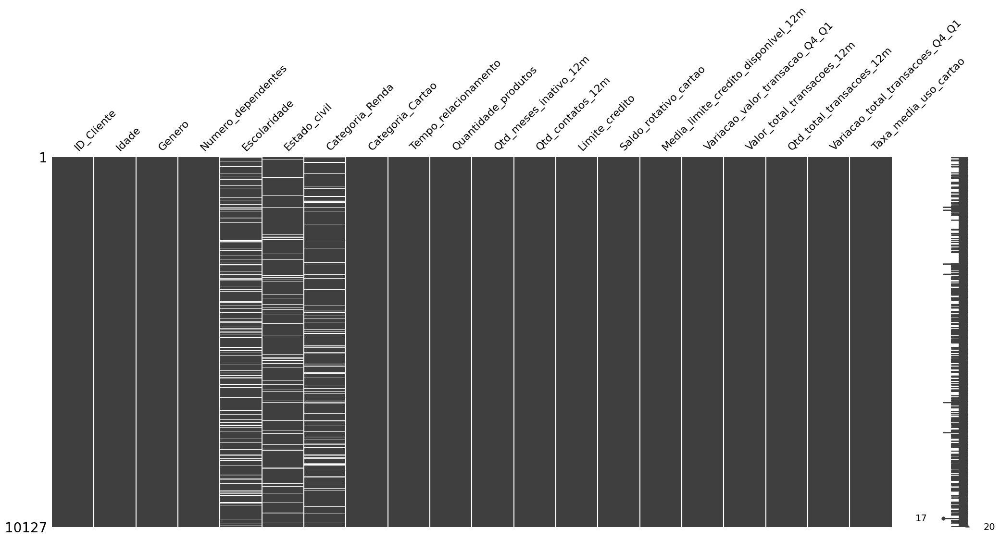

In [ ]:
# Salvando um novo dataset para subsituição dos valores "Unknown" por missings e posterior tratamento

# Recuperando o nome das colunas
col = list(clientes.columns)

# O novo dataset irá conter todas as colunas, com exceção da última coluna ('Churn')
clientes_com_missing = clientes[col[0:-1]]

# substitundo os valores "Unknown" por NaN
clientes_com_missing.replace("Unknown", np.nan, inplace = True)

# Exibindo visualização matricial da nulidade do dataset "clientes_com_missing"
ms.matrix(clientes_com_missing)

A exibição da matriz de nulidade dos dados possibilitou verificar que os dados missings se concentram nos atributos Escolaridade, Estado_civil e Categoria_Renda.

Como os dados faltantes referem-se a atributos categóricos e a atribuição de valores mais frequentes, nesse caso, pode distorcer o resultado do modelo, optamos por excluir as linhas com valores missings do novo conjunto de dados.

In [ ]:
# Excluindo as linhas com valores missing e atribuindo ao um novo dataset
clientes_sem_missing = clientes_com_missing.dropna(how = 'any')

# Incluindo a coluna "Churn" no novo dataset
clientes_sem_missing['Churn'] = clientes['Churn']

# Exibindo as informações do novo dataset "clientes_sem_missing"
clientes_sem_missing.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7081 entries, 0 to 10126
Data columns (total 21 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   ID_Cliente                           7081 non-null   int64  
 1   Idade                                7081 non-null   int64  
 2   Genero                               7081 non-null   object 
 3   Numero_dependentes                   7081 non-null   int64  
 4   Escolaridade                         7081 non-null   object 
 5   Estado_civil                         7081 non-null   object 
 6   Categoria_Renda                      7081 non-null   object 
 7   Categoria_Cartao                     7081 non-null   object 
 8   Tempo_relacionamento                 7081 non-null   int64  
 9   Quantidade_produtos                  7081 non-null   int64  
 10  Qtd_meses_inativo_12m                7081 non-null   int64  
 11  Qtd_contatos_12m             

Com a exclusão das linhas contendo valores missing o novo conjunto de dados passou a contar com 7081 instâncias e 21 atributos, incluindo a coluna **"ID_Cliente"**.

Examinando a distribuição percentual dos valores de cada atributo após a exclusão das instâncias com valores missing.

In [ ]:
# Exibindo o percentual de cada valor existente em cada atributo categórico no nova dataset "clientes_sem_missing"

for var in variaveis_categoricas:
    print(var) # Exibindo o nome da atributo
    print(clientes_sem_missing[var].value_counts()/len(clientes_sem_missing) * 100) # Contando os valores de cada atributo e dividindo pelo tamanho do dataset
    print("\n")

Genero
M    52.337241
F    47.662759
Name: Genero, dtype: float64


Escolaridade
Graduate         36.590877
High School      23.344160
Uneducated       17.003248
College          11.919220
Post-Graduate     6.086711
Doctorate         5.055783
Name: Escolaridade, dtype: float64


Estado_civil
Married     50.331874
Single      41.632538
Divorced     8.035588
Name: Estado_civil, dtype: float64


Categoria_Renda
Less than $40K    39.429459
$40K - $60K       19.940686
$80K - $120K      16.975004
$60K - $80K       15.576896
$120K +            8.077955
Name: Categoria_Renda, dtype: float64


Categoria_Cartao
Blue        93.178930
Silver       5.521819
Gold         1.143906
Platinum     0.155345
Name: Categoria_Cartao, dtype: float64




In [ ]:
# Exibindo o sumário estatístico do dataset "clientes_sem_missing" após a exclusão das linhas com missing
clientes_sem_missing.drop('ID_Cliente', axis = 1).describe().T

,count,mean,std,min,25%,50%,75%,max
Idade,7081.0,46.347691,8.041225,26.0,41.000,46.000,52.000,73.000
Numero_dependentes,7081.0,2.337805,1.291649,0.0,1.000,2.000,3.000,5.000
Tempo_relacionamento,7081.0,35.981359,8.002609,13.0,31.000,36.000,40.000,56.000
Quantidade_produtos,7081.0,3.819376,1.544444,1.0,3.000,4.000,5.000,6.000
Qtd_meses_inativo_12m,7081.0,2.342607,0.995104,0.0,2.000,2.000,3.000,6.000
Qtd_contatos_12m,7081.0,2.454456,1.104917,0.0,2.000,2.000,3.000,6.000
Limite_credito,7081.0,8492.773831,9126.072520,1438.3,2498.000,4287.000,10729.000,34516.000
Saldo_rotativo_cartao,7081.0,1167.501624,812.315606,0.0,463.000,1282.000,1781.000,2517.000
Media_limite_credito_disponivel_12m,7081.0,7325.272207,9131.217585,3.0,1248.000,3250.000,9491.000,34516.000
Variacao_valor_transacao_Q4_Q1,7081.0,0.760584,0.223139,0.0,0.629,0.735,0.858,3.397


Para preparação da conjunto de dados a sser utilizado no modelo de ML, realizamos a transformação das variávies categóricas em variáveis dummy, aumentando o número total de colunas do dataset.

In [ ]:
# Realizando a transformação das variavies Gênero, Escolaridade, Estado cívil, Categoria Renda, Categoria Cartão

# Fazendo uma copia do dataset clientes_sem_missing
clientes_sm_copia = clientes_sem_missing.copy()

# Definindo a lista de categorias para transformação
lista_categorias = ['Genero', 'Escolaridade', 'Estado_civil', 'Categoria_Renda', 'Categoria_Cartao']

# Realizando a transformação das variáveis categóricas em variávies dummy e atribuindo a novas colunas no dataset
dados_clientes = pd.get_dummies(clientes_sm_copia, columns = lista_categorias, drop_first = False)

# exibindo as 5 primeiras linhas deste novo dataset
dados_clientes.head()

,ID_Cliente,Idade,Numero_dependentes,Tempo_relacionamento,Quantidade_produtos,Qtd_meses_inativo_12m,Qtd_contatos_12m,Limite_credito,Saldo_rotativo_cartao,Media_limite_credito_disponivel_12m,...,Estado_civil_Single,Categoria_Renda_$120K +,Categoria_Renda_$40K - $60K,Categoria_Renda_$60K - $80K,Categoria_Renda_$80K - $120K,Categoria_Renda_Less than $40K,Categoria_Cartao_Blue,Categoria_Cartao_Gold,Categoria_Cartao_Platinum,Categoria_Cartao_Silver
0,768805383,45,3,39,5,1,3,12691.0,777,11914.0,...,0,0,0,1,0,0,1,0,0,0
1,818770008,49,5,44,6,1,2,8256.0,864,7392.0,...,1,0,0,0,0,1,1,0,0,0
2,713982108,51,3,36,4,1,0,3418.0,0,3418.0,...,0,0,0,0,1,0,1,0,0,0
4,709106358,40,3,21,5,1,0,4716.0,0,4716.0,...,0,0,0,1,0,0,1,0,0,0
5,713061558,44,2,36,3,1,2,4010.0,1247,2763.0,...,0,0,1,0,0,0,1,0,0,0


In [ ]:
# Reordenando as colunas do dataset após a transformação das variávies categóricas para que a coluna alvo ("Churn")
# seja a últma coluna do dataset.

# Alterando a ordem das colunas para que a coluna "Churn" fique na última posição
dados_clientes = dados_clientes[['ID_Cliente',
                                'Idade',
                                'Numero_dependentes',
                                'Tempo_relacionamento',
                                'Quantidade_produtos',
                                'Qtd_meses_inativo_12m',
                                'Qtd_contatos_12m',
                                'Limite_credito',
                                'Saldo_rotativo_cartao',
                                'Media_limite_credito_disponivel_12m',
                                'Variacao_valor_transacao_Q4_Q1',
                                'Valor_total_transacoes_12m',
                                'Qtd_total_transacoes_12m',
                                'Variacao_total_transacoes_Q4_Q1',
                                'Taxa_media_uso_cartao',
                                'Genero_F',
                                'Genero_M',
                                'Escolaridade_College',
                                'Escolaridade_Doctorate',
                                'Escolaridade_Graduate',
                                'Escolaridade_High School',
                                'Escolaridade_Post-Graduate',
                                'Escolaridade_Uneducated',
                                'Estado_civil_Divorced',
                                'Estado_civil_Married',
                                'Estado_civil_Single',
                                'Categoria_Renda_$120K +',
                                'Categoria_Renda_$40K - $60K',
                                'Categoria_Renda_$60K - $80K',
                                'Categoria_Renda_$80K - $120K',
                                'Categoria_Renda_Less than $40K',
                                'Categoria_Cartao_Blue',
                                'Categoria_Cartao_Gold',
                                'Categoria_Cartao_Platinum',
                                'Categoria_Cartao_Silver',
                                'Churn'
                                ]]

# Exibindo as 2 primeiras linhas do dataset para confirmar nova ordenação das colunas
dados_clientes.head(2)

,ID_Cliente,Idade,Numero_dependentes,Tempo_relacionamento,Quantidade_produtos,Qtd_meses_inativo_12m,Qtd_contatos_12m,Limite_credito,Saldo_rotativo_cartao,Media_limite_credito_disponivel_12m,...,Categoria_Renda_$120K +,Categoria_Renda_$40K - $60K,Categoria_Renda_$60K - $80K,Categoria_Renda_$80K - $120K,Categoria_Renda_Less than $40K,Categoria_Cartao_Blue,Categoria_Cartao_Gold,Categoria_Cartao_Platinum,Categoria_Cartao_Silver,Churn
0,768805383,45,3,39,5,1,3,12691.0,777,11914.0,...,0,0,1,0,0,1,0,0,0,0
1,818770008,49,5,44,6,1,2,8256.0,864,7392.0,...,0,0,0,0,1,1,0,0,0,0


In [ ]:
# Exibindo um resumo estatístico do novo dataset
dados_clientes.drop('ID_Cliente', axis = 1).describe().T

,count,mean,std,min,25%,50%,75%,max
Idade,7081.0,46.347691,8.041225,26.0,41.000,46.000,52.000,73.000
Numero_dependentes,7081.0,2.337805,1.291649,0.0,1.000,2.000,3.000,5.000
Tempo_relacionamento,7081.0,35.981359,8.002609,13.0,31.000,36.000,40.000,56.000
Quantidade_produtos,7081.0,3.819376,1.544444,1.0,3.000,4.000,5.000,6.000
Qtd_meses_inativo_12m,7081.0,2.342607,0.995104,0.0,2.000,2.000,3.000,6.000
Qtd_contatos_12m,7081.0,2.454456,1.104917,0.0,2.000,2.000,3.000,6.000
Limite_credito,7081.0,8492.773831,9126.072520,1438.3,2498.000,4287.000,10729.000,34516.000
Saldo_rotativo_cartao,7081.0,1167.501624,812.315606,0.0,463.000,1282.000,1781.000,2517.000
Media_limite_credito_disponivel_12m,7081.0,7325.272207,9131.217585,3.0,1248.000,3250.000,9491.000,34516.000
Variacao_valor_transacao_Q4_Q1,7081.0,0.760584,0.223139,0.0,0.629,0.735,0.858,3.397


###**5.Construção do Modelo de Classificação**

####5.1 Separação em conjunto de treino e conjunto de teste

In [ ]:
# Preaparação dos dados

# Definindo o tamanho do conjunto de teste e a semente aleatória
test_size = 0.20
seed = 7

# Separação da base de treino e teste (holdout)
array = dados_clientes.values
X = array[:, 1:35] # Selecionando os atributos, excluindo a coluna ID_Cliente da seleção
Y = array[:, 35] # classe (target)




In [ ]:
X.shape[1] # verificando o número de colunas da base de treino

34

#### 5.2 Feature Selection

Para realização da seleção de atributos (Feature Selection) foram avaliados o tempo de execução e a variação na acurácia média dos diferentes algoritmos utilizados na modelagem inicial, a fim de verificar qual a melhor quantidade de atributos (valor de n) a ser usada na contrução do modelo.

Para isso foi utilizado o método SelectKBest da biblioteca Scikit-Learn, aplicando a seleção univariada de recursos.

Foi possível perceber que uma quantidade de features maior que 10 não apresentou melhora significativa na acurácia média e aumentou o tempo de processamento dos modelos.

Por essa razão, optamos por definir como 10 a quantidade de atributos a serem selecionados na aplicação do Feature Selection,  com objetivo de produzir a melhor relação entre desempenho e custo computacional (trade-off).

A tabela a seguir relaciona a média dos valores de acurácia e a média dos vaçlores do desvio padrão para os diferentes algoritmos avaliados com definição de diferentes números de features comparados no método SelectKBest.

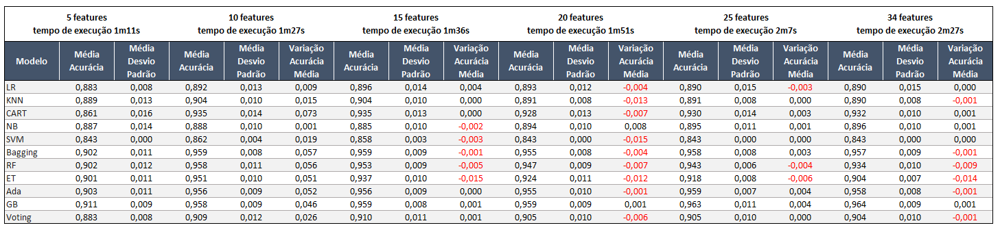

In [ ]:
# Realizando a Feature Selection utilizando o método SelectKBest

# Seleção de atributos com SelectKBest
best_var = SelectKBest(score_func = f_classif, k = 10) # Testando a seleção de metade dos atributos

# Executa a função de pontuação em (X, y) e obtém os atributos selecionados
fit = best_var.fit(X, Y)

# Reduz X para os atributos selecionados
X_fs = fit.transform(X) # Nova seleção de atributos após a aplicação do feature selection

# Resultados
print('\nNúmero original de atributos:', X.shape[1])
print('\nNúmero reduzido de atributos:', X_fs.shape[1])

# Exibe os atributos orginais
print("\nAtributos Originais:", dados_clientes.columns[1:35])

# Exibe as pontuações de cada atributos e os 17 escolhidos (com as pontuações mais altas)
np.set_printoptions(precision=3) # 3 casas decimais
print("\nScores dos Atributos Originais:", fit.scores_)
print("\nAtributos Selecionados:", best_var.get_feature_names_out(input_features = dados_clientes.columns[0:34]))


Número original de atributos: 34

Número reduzido de atributos: 10

Atributos Originais: Index(['Idade', 'Numero_dependentes', 'Tempo_relacionamento',
       'Quantidade_produtos', 'Qtd_meses_inativo_12m', 'Qtd_contatos_12m',
       'Limite_credito', 'Saldo_rotativo_cartao',
       'Media_limite_credito_disponivel_12m', 'Variacao_valor_transacao_Q4_Q1',
       'Valor_total_transacoes_12m', 'Qtd_total_transacoes_12m',
       'Variacao_total_transacoes_Q4_Q1', 'Taxa_media_uso_cartao', 'Genero_F',
       'Genero_M', 'Escolaridade_College', 'Escolaridade_Doctorate',
       'Escolaridade_Graduate', 'Escolaridade_High School',
       'Escolaridade_Post-Graduate', 'Escolaridade_Uneducated',
       'Estado_civil_Divorced', 'Estado_civil_Married', 'Estado_civil_Single',
       'Categoria_Renda_$120K +', 'Categoria_Renda_$40K - $60K',
       'Categoria_Renda_$60K - $80K', 'Categoria_Renda_$80K - $120K',
       'Categoria_Renda_Less than $40K', 'Categoria_Cartao_Blue',
       'Categoria_Cartao_G

#### 5.3 Modelagem e Inferência



Separando o conjunto de dados a serem utilizadas no modelo de ML após a seleção de features na proporção de 20% para a base de teste e 80% para a base de treinamento, de forma estratificada para garantir que as frequências relativas das classes sejam aproximadamente preservadas em cada fold de treino e validação.

In [ ]:
X = X_fs # reduzindo a quantidade de atributos antes da separação da base de treino e teste,
         # atribuindo à X o resultado da Feature Selection
X.shape # exibindo shape do novo conjunto de atributos

(7081, 10)

In [ ]:
# Fazendo a divisão das bases
X_train, X_test, Y_train, Y_test = train_test_split(X,
                                                    Y,
                                                    test_size = test_size,
                                                    shuffle = True,
                                                    random_state = seed,
                                                    stratify = Y)

Construindo uma modelagem inicial utilizando validação cruzada para treinar e avaliar os modelos com a configuração padrão de hiperparâmetros da bibliteca Scikit-Learn.

Utilizando como métrica a média dos valores de acurácia obtidos na validação cruzada com 10 folds para avaliação inicial dos modelos.

In [ ]:
# Parâmetros e partições da validação cruzada
scoring = 'accuracy'
num_particoes = 10
kfold = StratifiedKFold(n_splits = num_particoes,
                        shuffle = True,
                        random_state = seed) # Validação cruzada com estratificação

Realizando uma modelagem inicial.

LR: 0.892485 (0.013332)
KNN: 0.903955 (0.010274)
CART: 0.934502 (0.013733)
NB: 0.887537 (0.009866)
SVM: 0.861582 (0.004467)
Bagging: 0.959219 (0.007939)
RF: 0.958160 (0.011045)
ET: 0.951450 (0.009857)
Ada: 0.955862 (0.009247)
GB: 0.957629 (0.009439)
Voting: 0.909252 (0.011633)


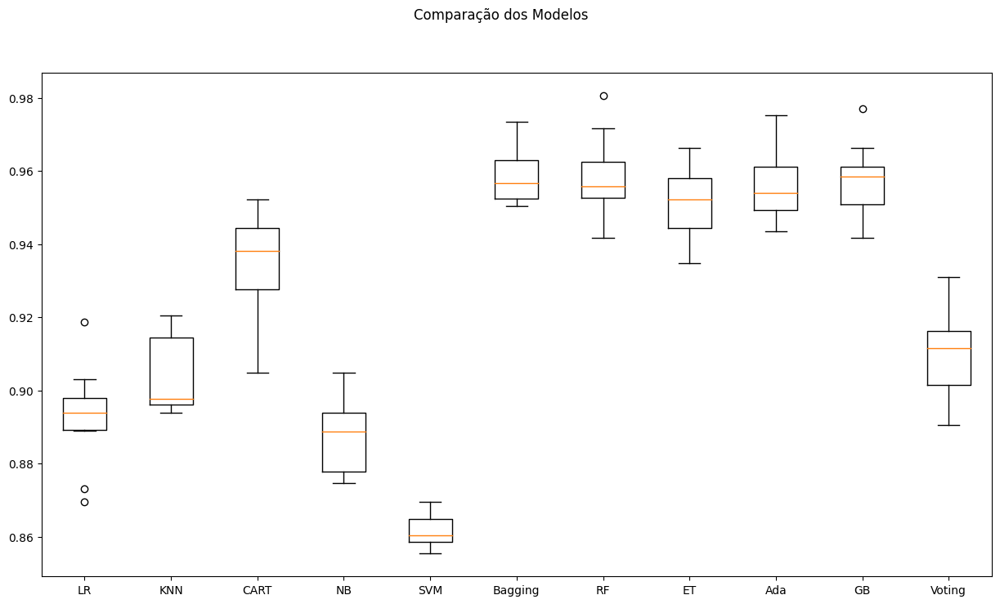

In [ ]:
# Definindo uma semente global
np.random.seed(7)

# Lista que armazenará os modelos
models = []

# Criando os modelos e adicionando-os na lista de modelos
models.append(('LR', LogisticRegression(max_iter = 200)))
models.append(('KNN', KNeighborsClassifier()))
models.append(('CART', DecisionTreeClassifier()))
models.append(('NB', GaussianNB()))
models.append(('SVM', SVC()))

# Definindo os parâmetros do classificador base para o BaggingClassifier
base = DecisionTreeClassifier()
num_trees = 100
max_features = 3
n_iter_no_change = 5
validation_fraction = 0.1

# Criando os modelos para o VotingClassifier
bases = []
model1 = LogisticRegression(max_iter = 200)
bases.append(('logistic', model1))
model2 = DecisionTreeClassifier()
bases.append(('cart', model2))
model3 = SVC()
bases.append(('svm', model3))

# Criando os ensembles e adicionando-os na lista de modelos
models.append(('Bagging', BaggingClassifier(base_estimator = base, n_estimators = num_trees)))
models.append(('RF', RandomForestClassifier(n_estimators = num_trees, max_features = max_features)))
models.append(('ET', ExtraTreesClassifier(n_estimators = num_trees, max_features = max_features)))
models.append(('Ada', AdaBoostClassifier(n_estimators = num_trees)))
models.append(('GB', GradientBoostingClassifier(n_estimators = num_trees,
                                                n_iter_no_change = n_iter_no_change, # definindo o número de iterações para parada antecipada
                                                validation_fraction = validation_fraction))) # definindo a base de validação para parada antecipada
                                                                                             # (early stopping) quando não houver melhora na score
                                                                                             # de validação
models.append(('Voting', VotingClassifier(bases)))

# Listas para armazenar os resultados
results = []
names = []

# Avaliação dos modelos
for name, model in models:
    cv_results = cross_val_score(model, X_train, Y_train, cv = kfold, scoring = scoring)
    results.append(cv_results)
    names.append(name)
    msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
    print(msg)

# Boxplot de comparação dos modelos
fig = plt.figure(figsize = (15,8))
fig.suptitle('Comparação dos Modelos')
ax = fig.add_subplot(111)
plt.boxplot(results)
ax.set_xticklabels(names)
plt.show()


Utilizando a Biblioteca **Pipeline** para criar e avaliar os modelos utilizando validação cruzada com os dados de treino padronizados e normalizados e comparar seus resultados com os resultados obtidos com o *dataset original*.

O modelo com melhor valor médio de acurácia será utilizado como modelo final.

Construindo e avaliando os modelos com os dados padronizados e normalizados.

LR-orig: 0.892 (0.013)
KNN-orig: 0.904 (0.010)
CART-orig: 0.935 (0.014)
NB-orig: 0.888 (0.010)
SVM-orig: 0.862 (0.004)
Bag-orig: 0.959 (0.008)
RF-orig: 0.958 (0.011)
ET-orig: 0.951 (0.010)
Ada-orig: 0.956 (0.009)
GB-orig: 0.958 (0.009)
Vot-orig: 0.909 (0.012)
LR-padr: 0.898 (0.010)
KNN-padr: 0.923 (0.009)
CART-padr: 0.934 (0.013)
NB-padr: 0.884 (0.010)
SVM-padr: 0.937 (0.010)
Bag-padr: 0.959 (0.009)
RF-padr: 0.959 (0.009)
ET-padr: 0.950 (0.010)
Ada-padr: 0.956 (0.009)
GB-padr: 0.959 (0.008)
Vot-padr: 0.936 (0.010)
LR-norm: 0.899 (0.010)
KNN-norm: 0.921 (0.005)
CART-norm: 0.936 (0.015)
NB-norm: 0.884 (0.010)
SVM-norm: 0.924 (0.009)
Bag-norm: 0.958 (0.008)
RF-norm: 0.959 (0.011)
ET-norm: 0.951 (0.009)
Ada-norm: 0.956 (0.009)
GB-norm: 0.959 (0.011)
Vot-norm: 0.926 (0.010)


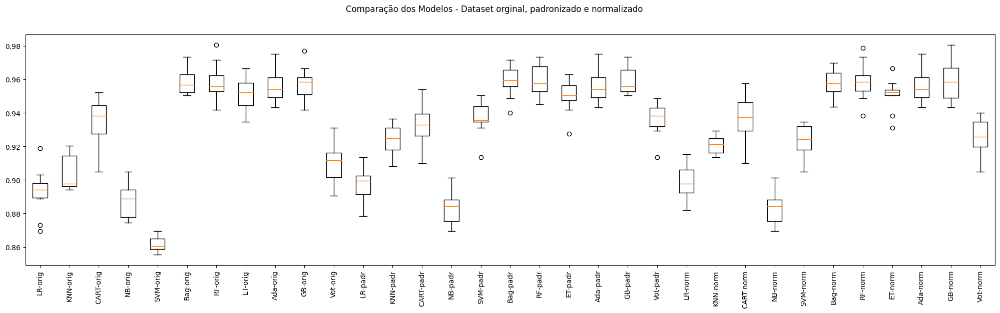

In [ ]:
np.random.seed(7) # definindo uma semente global para este bloco

# Listas para armazenar os armazenar os pipelines e os resultados para todas as visões do dataset
pipelines = []
results = []
names = []

# Criando os elementos do pipeline

# Algoritmos que serão utilizados
reg_log = ('LR', LogisticRegression(max_iter = 200))
knn = ('KNN', KNeighborsClassifier())
cart = ('CART', DecisionTreeClassifier())
naive_bayes = ('NB', GaussianNB())
svm = ('SVM', SVC())
bagging = ('Bag', BaggingClassifier(base_estimator = base, n_estimators = num_trees))
random_forest = ('RF', RandomForestClassifier(n_estimators = num_trees, max_features = max_features))
extra_trees = ('ET', ExtraTreesClassifier(n_estimators = num_trees, max_features = max_features))
adaboost = ('Ada', AdaBoostClassifier(n_estimators = num_trees))
gradient_boosting = ('GB', GradientBoostingClassifier(n_estimators = num_trees,
                                                      n_iter_no_change = n_iter_no_change, # definindo o número de iterações para parada antecipada
                                                      validation_fraction = validation_fraction)) # definindo a base de validação para parada antecipada
                                                                                                  # (early stopping) quando não houver melhora na score
                                                                                                  # de validação
voting = ('Voting', VotingClassifier(bases))

# Transformações que serão utilizadas
standard_scaler = ('StandardScaler', StandardScaler())
min_max_scaler = ('MinMaxScaler', MinMaxScaler())

# Montando os pipelines

# Dataset original
pipelines.append(('LR-orig', Pipeline([reg_log])))
pipelines.append(('KNN-orig', Pipeline([knn])))
pipelines.append(('CART-orig', Pipeline([cart])))
pipelines.append(('NB-orig', Pipeline([naive_bayes])))
pipelines.append(('SVM-orig', Pipeline([svm])))
pipelines.append(('Bag-orig', Pipeline([bagging])))
pipelines.append(('RF-orig', Pipeline([random_forest])))
pipelines.append(('ET-orig', Pipeline([extra_trees])))
pipelines.append(('Ada-orig', Pipeline([adaboost])))
pipelines.append(('GB-orig', Pipeline([gradient_boosting])))
pipelines.append(('Vot-orig', Pipeline([voting])))

# Dataset Padronizado
pipelines.append(('LR-padr', Pipeline([standard_scaler, reg_log])))
pipelines.append(('KNN-padr', Pipeline([standard_scaler, knn])))
pipelines.append(('CART-padr', Pipeline([standard_scaler, cart])))
pipelines.append(('NB-padr', Pipeline([standard_scaler, naive_bayes])))
pipelines.append(('SVM-padr', Pipeline([standard_scaler, svm])))
pipelines.append(('Bag-padr', Pipeline([standard_scaler, bagging])))
pipelines.append(('RF-padr', Pipeline([standard_scaler, random_forest])))
pipelines.append(('ET-padr', Pipeline([standard_scaler, extra_trees])))
pipelines.append(('Ada-padr', Pipeline([standard_scaler, adaboost])))
pipelines.append(('GB-padr', Pipeline([standard_scaler, gradient_boosting])))
pipelines.append(('Vot-padr', Pipeline([standard_scaler, voting])))

# Dataset Normalizado
pipelines.append(('LR-norm', Pipeline([min_max_scaler, reg_log])))
pipelines.append(('KNN-norm', Pipeline([min_max_scaler, knn])))
pipelines.append(('CART-norm', Pipeline([min_max_scaler, cart])))
pipelines.append(('NB-norm', Pipeline([min_max_scaler, naive_bayes])))
pipelines.append(('SVM-norm', Pipeline([min_max_scaler, svm])))
pipelines.append(('Bag-norm', Pipeline([min_max_scaler, bagging])))
pipelines.append(('RF-norm', Pipeline([min_max_scaler, random_forest])))
pipelines.append(('ET-norm', Pipeline([min_max_scaler, extra_trees])))
pipelines.append(('Ada-norm', Pipeline([min_max_scaler, adaboost])))
pipelines.append(('GB-norm', Pipeline([min_max_scaler, gradient_boosting])))
pipelines.append(('Vot-norm', Pipeline([min_max_scaler, voting])))

# Executando os pipelines
for name, model in pipelines:
    cv_results = cross_val_score(model, X_train, Y_train, cv = kfold, scoring = scoring) # aplicando as transformações do Pipeline na base de treino
    results.append(cv_results)                                                           # utilizando k = 10 e a acurácia para comparação dos resultados
    names.append(name)
    msg = "%s: %.3f (%.3f)" % (name, cv_results.mean(), cv_results.std()) # formatando para 3 casas decimais
    print(msg)

# Boxplot de comparação dos modelos
fig = plt.figure(figsize=(25,6))
fig.suptitle('Comparação dos Modelos - Dataset orginal, padronizado e normalizado')
ax = fig.add_subplot(111)
plt.boxplot(results)
ax.set_xticklabels(names, rotation = 90)
plt.show()

Após a avaliação dos resultados com o dataset original, o dataset padronizado e o dataset normalizado foi possível observar que houve melhora no desempenho aplicando a padronização dos dados para os modelos de *KNN e SVM*, além do ensemble baseado no método *Votting*.

Os modelos baseados em *Regressão Logística e CART* obtiveram melhores resultados com a realização da normalização dos dos dados.

Os modelos baseados nos algortimos *Naive Bayes Classifier e Extra Trees* e os métodos utilizando técnicas de ensemble *bagging* e *Adaboost* obtiveram resultados iguais ou piores com os dados padronizados ou normalizados, quando comparados com os resultados obtidos com o dataset original.

Entre todos os modelos avalidados, **o modelo GB apresentou o melhor resultado de acurácia** e por essa razão será utilizado para construção do modelo final.

Por ter apresentando resultados semelhantes para o conjunto de dados padronizado e normalizado, optaremos por utilizar o conjunto de dados **normalizado**, alterando os valores para uma escala comum.

##### 5.3.1 Otimização dos hiperparâmetros

Realizando a otimização dos hiperparâmetros para o modelo GB, que apresentou o melhor desempenho entre os modelos avaliados.

In [ ]:
# Tuning do Modelo GB

np.random.seed(7) # definindo uma semente global para este bloco

pipelines = []

# Definindo os componentes do pipeline
GB = ('GB', GradientBoostingClassifier(n_estimators = num_trees,
                                       n_iter_no_change = n_iter_no_change,
                                       validation_fraction = validation_fraction))
min_max_scaler = ('MinMaxScaler', MinMaxScaler())

pipelines.append(('GB-norm', Pipeline(steps = [min_max_scaler, gradient_boosting])))

param_grid = {
    'GB__learning_rate': [0.3, 0.1, 0.01],
    'GB__subsample': [1.0, 0.85, 0.75],
    'GB__max_depth': [5, 3, 2],
    'GB__min_samples_split': [100, 50, 2],
    'GB__min_samples_leaf': [100, 50, 1]
}

# Prepara e executa o GridSearchCV
for name, model in pipelines:
    grid = GridSearchCV(estimator = model, param_grid = param_grid, scoring = scoring, cv = kfold)
    grid.fit(X_train, Y_train)
    # imprime a melhor configuração
    print("Melhores parâmetros encontrados com Grid Searh: %s - Melhor Score: %f usando %s" % (name, grid.best_score_, grid.best_params_))

Melhores parâmetros encontrados com Grid Searh: GB-norm - Melhor Score: 0.965043 usando {'GB__learning_rate': 0.3, 'GB__max_depth': 5, 'GB__min_samples_leaf': 50, 'GB__min_samples_split': 100, 'GB__subsample': 0.85}


### **6.Finalização do Modelo**

Após a seleção dos melhores hiperparâmetros, finalizamos a construção do modelo final e verificamos a acurácia do modelo na base de teste.

In [ ]:
# Avaliação do modelo com o conjunto de testes

# Melhores hiperparâmetros encontrado com Grid Search

learning_rate = 0.3
max_depth = 5
subsample = 0.85
min_samples_split = 100
min_samples_leaf = 50


# Preparação do modelo
model = GradientBoostingClassifier(n_estimators = num_trees,
                                   learning_rate = learning_rate,
                                   subsample = subsample,
                                   min_samples_split = min_samples_split,
                                   min_samples_leaf = min_samples_leaf,
                                   max_depth = max_depth,
                                   n_iter_no_change = n_iter_no_change,         # definindo o número de iterações para parada antecipada
                                   validation_fraction = validation_fraction)   # definindo a base de validação para parada antecipada
                                                                                # (early stopping) quando não houver melhora na score
                                                                                # de validação

# Aplicação do Modelo com os dados normalizados
normalizer = MinMaxScaler().fit(X_train) # ajuste do scaler com o conjunto de treino
normalizedX = normalizer.transform(X_train)  # aplicação da normalização no conjunto de treino
model.fit(normalizedX, Y_train)

# Estimativa da acurácia no conjunto de teste com os dados normalizados
normalizedTestX = normalizer.transform(X_test)    # aplicação da normalização no conjunto de teste
predictions = model.predict(normalizedTestX)

# imprimindo os resultado com dados normalizados de Acurácia, Precisão, Recall e F1-Score
Y_true = Y_test
Y_pred = predictions

print(accuracy_score(Y_true, Y_pred))
print(precision_score(Y_true, Y_pred, average = 'binary', pos_label = '1'))
print(recall_score(Y_true, Y_pred, average = 'binary', pos_label = '1'))
print(f1_score(Y_true, Y_pred, average = 'binary', pos_label = '1'), '\n')

# Imprimindo o resultado com os dados normalizados
print("Acurácia do modelo após a aplicação na base de teste (dados normalizados): %.3f" % (accuracy_score(Y_test, predictions)))
print("Precisão do modelo após a aplicação na base de teste (dados normalizados): %.3f" % (precision_score(Y_true, Y_pred, average = 'binary', pos_label = '1')))
print("Recall do modelo após a aplicação na base de teste (dados normalizados): %.3f" % (recall_score(Y_true, Y_pred, average = 'binary', pos_label = '1')))
print("F1-Score do modelo após a aplicação na base de teste (dados normalizados): %.3f" % (f1_score(Y_true, Y_pred, average = 'binary', pos_label = '1')))

0.963302752293578
0.8868778280542986
0.8789237668161435
0.8828828828828829 

Acurácia do modelo após a aplicação na base de teste (dados normalizados): 0.963
Precisão do modelo após a aplicação na base de teste (dados normalizados): 0.887
Recall do modelo após a aplicação na base de teste (dados normalizados): 0.879
F1-Score do modelo após a aplicação na base de teste (dados normalizados): 0.883


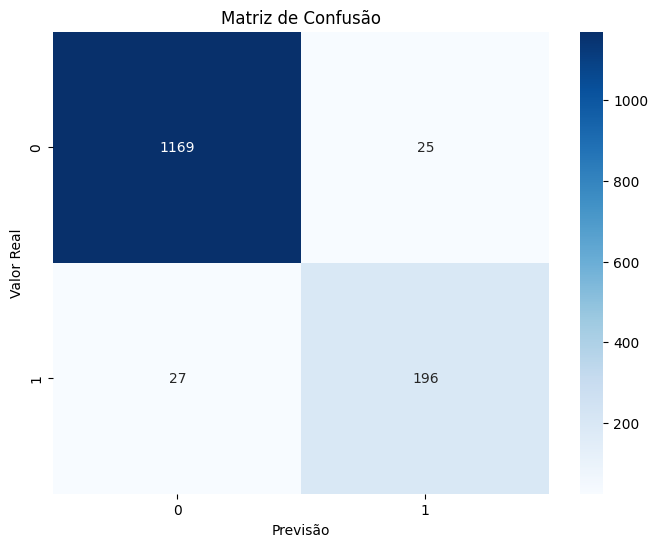

In [ ]:
# Matriz de confusão
cm = confusion_matrix(Y_test, predictions)

# Visualização da matriz de confusão
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Matriz de Confusão')
plt.xlabel('Previsão')
plt.ylabel('Valor Real')
plt.show()

In [ ]:
# Preparação do modelo com TODO o dataset

# Dados normalizados
normalizer = MinMaxScaler().fit(X) # ajuste do scaler com TODO o dataset
normalizedX = normalizer.transform(X) # aplicação da padronização com TODO o dataset
model.fit(normalizedX, Y)

GradientBoostingClassifier(learning_rate=0.3, max_depth=5, min_samples_leaf=50,
                           min_samples_split=100, n_iter_no_change=5,
                           subsample=0.85)

### **7.Conclusão**

O Modelo construído baseado em boosting apresentou um elavado nível de acurácia quando submetida a base de teste, mostrando ter uma alta capacidade preditiva para o fenomeno do churn de clientes.

A **Acurácia** do Modelo, que indica a taxa de erro geral, **foi de 96.3%**. Em relação à classe de interesse, a **Precisão**, que avalia a razão entre o número de predições verdadeiras positivas e a quantidade total de predições positivas, **foi de 88,7%** e o **Recall**, que avalia o número de predições verdadeiras positivas e a quantidade total de exemplos positivos no conjunto de dados, **foi de 87,9%**, indicando que modelo também foi capaz de ter bons resultados para a classe alvo. Além disso, o modelo também apresentou um bom resultado para a métrica **F1-Score**, de **88,3%**, demonstrando ter uma boa qualidade geral.

Os atributos selecionados no modelo ***Tempo de Relacionamento, Quantidade de Produtos, Quantidade de Meses Inativo nos Últimos 12 Meses, Limite de Crédito, Média de Limite de Crédito Disponível nos Últimos 12 meses, Variação do Valor de Transação Q4-Q1, Valor Total de Transações nos Últimos 12 meses, Quantidade Total de Transações em 12 Meses, Variação Total de Transações Q4-Q1 e Gênero do Cliente*** podem indicar caracterísiticas importantes dos clientes que devem ser avaliadas pelas insituições financeiras para previsão da evasão ou abandono do cliente e com isso promover ações direcionadas para o marketing de rentenção.

Os resultados sugerem ainda que o modelo pode ser colocado em uso, dado seu elevado indíce de acerto.

## **Parte B - Modelo de *Deep Learning***

#### **Classificador de imagens binário - Classificação de pacientes com Covid-19**


**Contexto:** Trata-se de um conjunto de imagens reais de Tomografias Computadorizadas de pacientes testaram positivo para infecção por SARS-Cov-2 (Covid-19) e de pacientes não infectados pelo vírus SARS-CoV-2 coletadas de diferentes pacientes em hospitais da cidade de São Paulo-SP. São 1.252 imagens de pacientes com diagnóstico de infecção por COVID-19 e 1.229 imagens de pacientes sem infecção viral, totalizando 2.481 imagens em todo o dataset. O objetivo deste notebook é construir um modelo de visão computacional que consiga classificar as imagens em uma das categorias acima mencionadas.

**Estrutura:** O notebook está dividido assim:

1. Importação das bibliotecas
2. Acesso e tratamento dos dados que serão a entrada do modelo de deep learning
3. Configuração do modelo de deep learning usando uma rede neural convolucional (CNN) simples com Keras
4. Treinamento do modelo de deep learning
5. Execução do modelo de deep learning treinado em um subconjunto das imagens de teste
6. Avaliação do modelo de deep learning
7. Conclusão
8. Exportação do modelo de deep learning
9. Teste do modelo exportado

**Dataset:** O conjunto de dados foi baixado do Kaggle e foram utilizados para publização do artigo:

Soares, Eduardo, Angelov, Plamen, Biaso, Sarah, Higa Froes, Michele, and Kanda Abe, Daniel. "SARS-CoV-2 CT-scan dataset: A large dataset of real patients CT scans for SARS-CoV-2 identification." medRxiv (2020). doi: https://doi.org/10.1101/2020.04.24.20078584.

**Link da base de dados no Kaggle:**

https://www.kaggle.com/datasets/plameneduardo/sarscov2-ctscan-dataset?resource=download

### **1.Importação das bibliotecas**

In [ ]:
# Instalando o pacote "wget" para download do arquivo zip disponível no repositório do github
!pip install wget

# Instalando Tensorflow, Keras, Pandas e Scikit-learn
!pip install tensorflow
!pip install keras
!pip install pandas
!pip install scikit-learn

  Preparing metadata (setup.py) ... done
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9657 sha256=a5e0e9a8a09d4cc15cc706dc14484eaa76878ce75e19a8d81c8c71f49ac60f1d
  Stored in directory: /root/.cache/pip/wheels/8b/f1/7f/5c94f0a7a505ca1c81cd1d9208ae2064675d97582078e6c769
Successfully built wget


In [ ]:
# importando as bibliotecas necessárias para análise e construção do modelo

from keras.preprocessing.image import ImageDataGenerator
from keras import layers
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout, Conv2D, AveragePooling2D, Flatten
from keras import models
from keras import optimizers
from keras import callbacks
from tensorflow.keras.preprocessing import image
import os
from sklearn.model_selection import train_test_split
import shutil
import random
import math
import numpy as np
import zipfile
import pandas as pd
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import seaborn as sns
from datetime import datetime
from tensorflow import keras
from sklearn.metrics import confusion_matrix, classification_report
import sklearn.metrics as skm
import itertools
import numpy as np
import matplotlib.pyplot as plt

#### **Utilidades**


`plot_confusion_matrix` é uma função python que imprime uma matriz de confusão

In [ ]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    Esta função imprime e plota a matriz de confusão.
    A normalização pode ser aplicada definindo `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Matriz de confusão normalizada")
    else:
        print('Matriz de confusão sem normalização')

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('Label real')
    plt.xlabel('Label predito')

### **2. Acessando e tratando os dados que serão a entrada do modelo de deep learning**

As imagens estão organizadas em 1 única pasta disponível em arquivo compactado no Github, tendo cada classe rotulada (label) no nome do arquivo.

Para a construção do modelo utilizamos a biblioteca **"wget"** para importação do arquivo em formato zip para o ambiente do Google Colab.

In [ ]:
# Fazendo o download o arquivo zip disponível no github para uma pasta de arquivos do Colab
!wget https://github.com/Daniel-tns/MVP2/raw/main/dados_covid.zip

--2023-07-23 01:04:33--  https://github.com/Daniel-tns/MVP2/raw/main/dados_covid.zip
Resolving github.com (github.com)... 140.82.113.3
Connecting to github.com (github.com)|140.82.113.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://media.githubusercontent.com/media/Daniel-tns/MVP2/main/dados_covid.zip [following]
--2023-07-23 01:04:33--  https://media.githubusercontent.com/media/Daniel-tns/MVP2/main/dados_covid.zip
Resolving media.githubusercontent.com (media.githubusercontent.com)... 185.199.108.133, 185.199.111.133, 185.199.109.133, ...
Connecting to media.githubusercontent.com (media.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 241571368 (230M) [application/zip]
Saving to: ‘dados_covid.zip’

dados_covid.zip     100%[===================>] 230.38M   102MB/s    in 2.3s    

2023-07-23 01:04:40 (102 MB/s) - ‘dados_covid.zip’ saved [241571368/241571368]



Descompactando o arquivo e direcionando para a pasta **"train_images"**

In [ ]:
# Path onde se encontra o arquivo 'dados_covid.zip'
train = '/content/dados_covid.zip'
destination = '/content/train_images/'

# Criando a pasta de destino se necessário
os.makedirs(destination, exist_ok = True)

with zipfile.ZipFile(train,'r') as zip_ref:
    zip_ref.extractall(destination)

Verificando a pasta que foi extraída do `zip`.

In [ ]:
r = '/content/train_images/'
print(os.listdir(r))

['COVID']


Verificando o número de imagens que foram extraídas.

In [ ]:
path ='/content/train_images/COVID/'
print(f"Temos um total de {len(os.listdir(path))} imagens para o treinamento e avaliação do modelo de deep learning")

Temos um total de 2481 imagens para o treinamento e avaliação do modelo de deep learning


Exibindo alguns exemplos de algumas imagens extraídas.

In [ ]:
# exibindo nome dos arquivos das primeiras 20 imagens do dataset
print(f"Primeiras 20 imagens: \n {os.listdir(path)[:20]}")

Primeiras 20 imagens: 
 ['Covid (151).png', 'Non-Covid (857).png', 'Non-Covid (558).png', 'Non-Covid (257).png', 'Non-Covid (666).png', 'Non-Covid (465).png', 'Non-Covid (569).png', 'Covid (890).png', 'Non-Covid (1203).png', 'Non-Covid (1123).png', 'Covid (1009).png', 'Non-Covid (444).png', 'Covid (760).png', 'Covid (1179).png', 'Covid (1121).png', 'Non-Covid (841).png', 'Covid (847).png', 'Non-Covid (1101).png', 'Non-Covid (656).png', 'Non-Covid (860).png']


Criando um dataframe com as informações das imagens

In [ ]:
images = os.listdir(path)

labels, heights, widths, channels, filesize = [], [], [], [], []

# Loop que percorre cada uma das imagens extraídas
for fname in images:

    labels.append(str(fname)[:3])
    img_shape = mpimg.imread(path+fname).shape
    heights.append(img_shape[0])
    widths.append(img_shape[1])
    channels.append(img_shape[2])
    filesize.append(os.path.getsize(path+fname))

# Criação do dataset
df_imagens = pd.DataFrame({'images': images, 'class': labels, 'height': heights,
                        'width': widths, 'channels': channels, 'filesize': filesize})

df_imagens.head()

,images,class,height,width,channels,filesize
0,Covid (151).png,Cov,243,331,3,98605
1,Non-Covid (857).png,Non,279,415,4,114304
2,Non-Covid (558).png,Non,245,351,4,84682
3,Non-Covid (257).png,Non,189,288,4,55474
4,Non-Covid (666).png,Non,254,360,4,90275


Ao criarmos o dataframe, atribuímos como classe para cada uma das imagens as 3 primeiras letras do arquivo, utilizando como label os termos "COV" ou "NON".

Para continuar a preparação dos dados para a construção do modelo substuíremos os termos "COV" e "NON" por "positivo" e "negativo", respectivamente.

In [ ]:
# Substituindo as classes "Cov" e "Non" por "positivo" e "negativo", respectivamente, na coluna class
df_imagens['class'] = df_imagens['class'].replace(["Cov", "Non"], ["positivo", "negativo"])

# Exibindo novamente o dataframe para confirmar a alteração
df_imagens.head()

,images,class,height,width,channels,filesize
0,Covid (151).png,positivo,243,331,3,98605
1,Non-Covid (857).png,negativo,279,415,4,114304
2,Non-Covid (558).png,negativo,245,351,4,84682
3,Non-Covid (257).png,negativo,189,288,4,55474
4,Non-Covid (666).png,negativo,254,360,4,90275


Exibindo a distribuição de imagens de cada classe.

positivo    1252
negativo    1229
Name: class, dtype: int64 



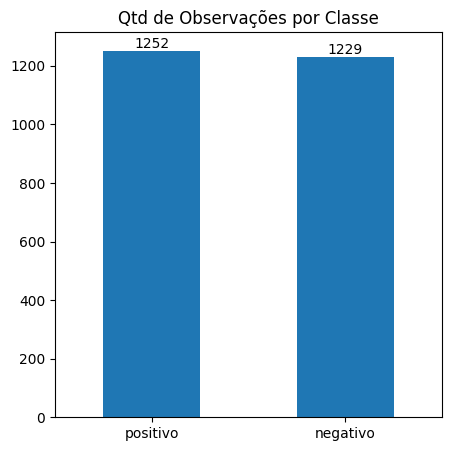

In [ ]:
# Visualizando a quantidade de instâncias por classe
print((df_imagens['class']).value_counts(), '\n')

# Plotando um grafico com a distribuição das Classes
ax = df_imagens['class'].value_counts().plot.bar(title = 'Qtd de Observações por Classe', rot = 0, figsize = (5, 5))
ax.bar_label(ax.containers[0], fmt="%.0f") # formatação do número com uma casa decimal
plt.show()

Observando a distribuição das classes é possível perceber que o conjunto de dados está equilibrado, com 50,46% das amostrar com resultado positivo (classe de interesse) e 49,54% com resultado negativo para infecção pelo virus SARS-CoV-2.

Visualizando algumas imagens do conjunto de dados.

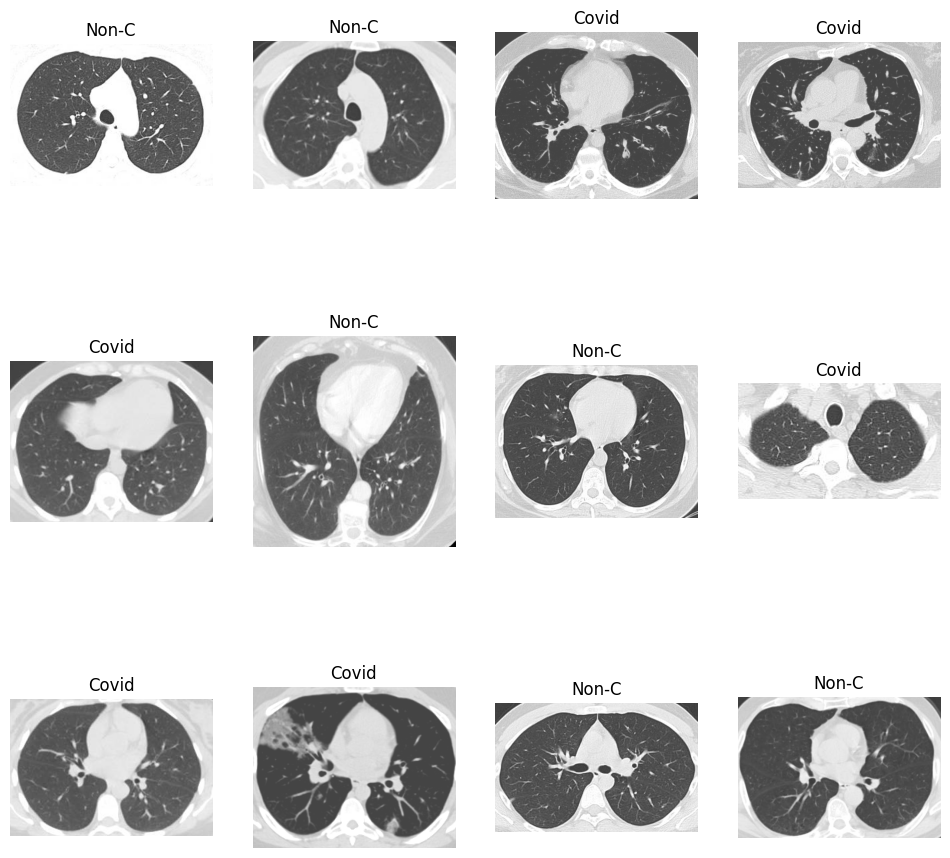

In [ ]:
# Definindo o tamanho das imagens para exibição
fig = plt.gcf()
fig.set_size_inches(3*4, 3*4)

# Visualizando apenas 12 imagens
for i in range(12):

    sample = np.random.choice(images)
    img_path =path+sample
    sp = plt.subplot(3, 4, i + 1)
    sp.axis('Off')
    img = mpimg.imread(img_path)
    plt.imshow(img)
    plt.title(sample[:5])

plt.show()

Realizando a divisão dos dados em treino e teste na proporção de 30% das imagens para teste e 70% para treinamento do modelo de *deep learning*.

In [ ]:
# Definindo o conjunto de treino e teste do modelo
train, test = train_test_split(df_imagens[['images' , 'class']],
                               test_size = 0.3,
                               random_state = 7,
                               shuffle = True)

Visualizando a divisão dos dados.

In [ ]:
# Imprimento os conjuntos de treino e teste para visualizar a divisão
print("============== Train: ==============")
print(train, '\n' *2)
print("============== Test:  ==============")
print(test)

============== Train: ==============
                    images     class
553    Non-Covid (382).png  negativo
830        Covid (537).png  positivo
757        Covid (863).png  positivo
264    Non-Covid (922).png  negativo
321        Covid (556).png  positivo
...                    ...       ...
211         Covid (63).png  positivo
1603   Non-Covid (702).png  negativo
537    Non-Covid (548).png  negativo
1220  Non-Covid (1113).png  negativo
175       Covid (1107).png  positivo

[1736 rows x 2 columns] 


============== Test:  ==============
                   images     class
637      Covid (1140).png  positivo
1989  Non-Covid (543).png  negativo
60    Non-Covid (970).png  negativo
832   Non-Covid (664).png  negativo
2193     Covid (1138).png  positivo
...                   ...       ...
1236  Non-Covid (175).png  negativo
1058     Covid (1188).png  positivo
1421  Non-Covid (433).png  negativo
2332      Covid (120).png  positivo
2381      Covid (110).png  positivo

[745 rows x 2 columns

#### **Preparação dos dados**

Para realizar a preparação dos dados utilizamos o método *ImageDataGenerator* para separar 20% das imagens em um conjunto de validação. O método também foi utilizado para alterar a escala das imagens e produzir rúído, reduzindo a possibilidade de ocorrer overfitting durante o treinamento. No conjunto de teste realizada apenas a alteração na escala das imagens.

Também foi utilizado o método flow_from_dataframe() para gerar imagens com aumento de dados a partir do dataframe contendo as imagens originais, o que também colabora para reduzir a probabilidade de haver overfitting no modelo. O overfitting geralmente ocorre quando há um pequeno número de exemplos de treinamento e o aumento de dados ajuda a expor o modelo a mais aspectos dos dados e a generalizar melhor (fonte: https://www.tensorflow.org/tutorials/images/classification?hl=pt-br#data_augmentation).

In [ ]:
# Preparação da base de treino, validação e teste

# Declaração das variáveis
validation_split = 0.2  # percentual das imagens da base de treino que serão usadas para a base de validação
rescale = 1./255        # alteração da escala das imagens
rotation_range = 40     # valor em graus em que as imagens da base de treino serão giradas aleatoriamente
shear_range = 0.2       # para transformações de shearing, deslocando as imagens de forma horizontal no plano geométrico
zoom_range = 0.2        # realiza ampliação aleatória das imagens
fill_mode = 'nearest'
target_size = (150, 150)
batch_size = 50

# Utilizando o ImageDataGenerator para alterar a escala das imagens, separar a base de validação e adicionar ruído ao conjunto de treino
train_datagen = ImageDataGenerator(validation_split = validation_split, # incluíndo base de validação no treinamento
                                    rescale = rescale,
                                    rotation_range = rotation_range,
                                    shear_range = shear_range,
                                    zoom_range = zoom_range,
                                    horizontal_flip = True, # inverte aleatoriamente metade das imagens horizontalmente
                                    fill_mode = fill_mode)

# Alterando a escala das imagens do conjunto de teste
test_datagen = ImageDataGenerator(rescale = rescale)

# definindo a base de treino
train_generator = train_datagen.flow_from_dataframe(train,
                                                    path,
                                                    target_size = target_size,
                                                    batch_size = batch_size,
                                                    class_mode = 'binary',
                                                    x_col = 'images',
                                                    y_col = 'class',
                                                    subset = 'training')

# definindo a base de validação
val_generator = train_datagen.flow_from_dataframe(train,
                                                  path,
                                                  target_size = target_size,
                                                  batch_size = batch_size,
                                                  class_mode = 'binary',
                                                  x_col = 'images',
                                                  y_col = 'class',
                                                  subset = 'validation')

# definindo a base de teste
test_generator = test_datagen.flow_from_dataframe(test,
                                                  path,
                                                  target_size = target_size,
                                                  batch_size = batch_size,
                                                  class_mode = 'binary',
                                                  x_col = 'images',
                                                  y_col = 'class')

Found 1389 validated image filenames belonging to 2 classes.
Found 347 validated image filenames belonging to 2 classes.
Found 745 validated image filenames belonging to 2 classes.


Visualizando um exemplo do tratamento das imagens.

Found 1 validated image filenames belonging to 1 classes.


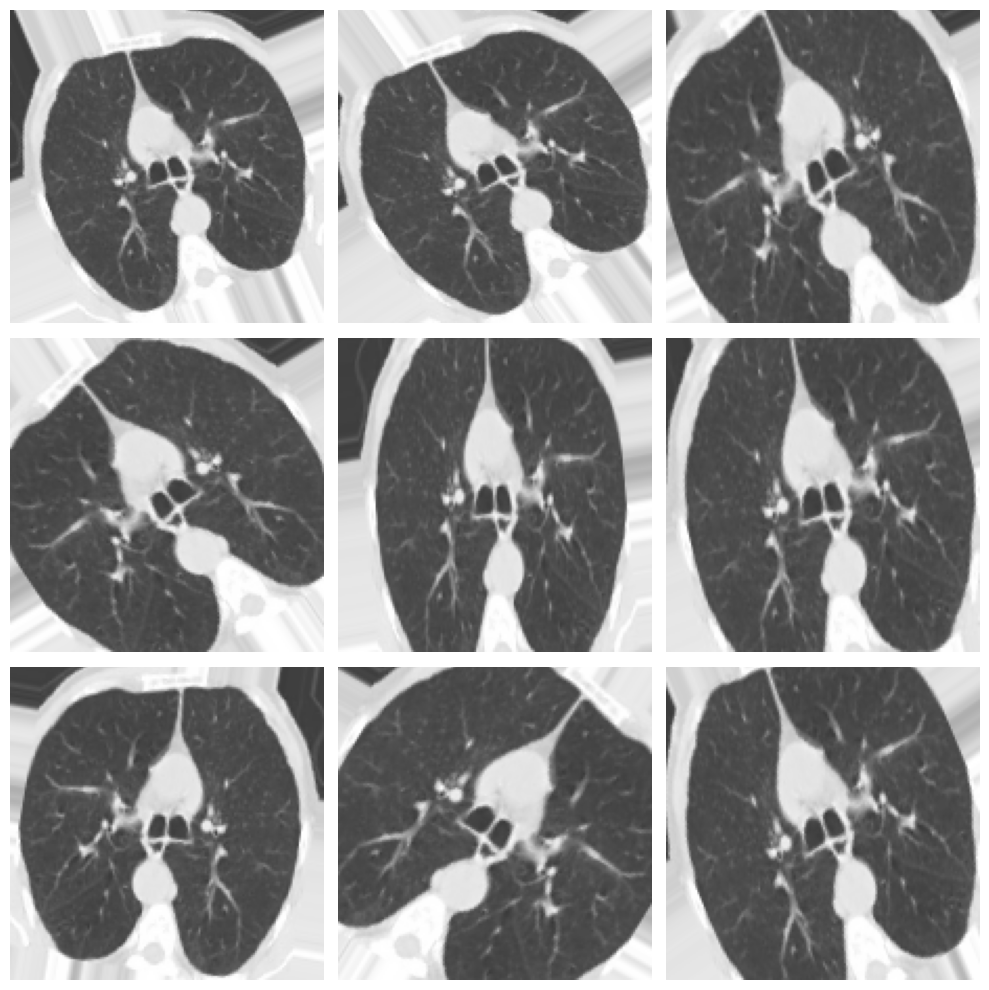

In [ ]:
# Pegando um registro do dataframe
sample = df_imagens.sample(n = 1)

# Neste caso o tipo de classe é categorico, pois temos um exemplo com apenas uma classe
sample_generator = train_datagen.flow_from_dataframe(sample,
                                                     path,
                                                     x_col = 'images',
                                                     y_col = 'class',
                                                     target_size = target_size,
                                                     class_mode = 'categorical')

plt.figure(figsize = (10, 10))
for i in range(9):
    plt.subplot(3, 3, i+1)
    for x_batch, y_batch in sample_generator:
        image = x_batch[0]
        plt.imshow(image)
        plt.axis('Off')
        break

plt.tight_layout()
plt.show()

### **3. Configuração de um modelo de *deep learning* usando uma rede neural convolucional (CNN) simples com a biblioteca Keras**


#### Definição da arquitetura do modelo

Para construção da arquitura do modelo utilizamos inicialmente uma camada convolucional 2D com 16 filtros, tamanho de de filtro 3x3 utilizando uma função de ativação *ReLU* e forma das imagens (150x150x3). É adicionada uma camada *MaxPooling* 2x2 e a mesma função de ativação.

Na sequência são adicionadas 4 camadas convulucionais 2D utilizando também a mesma função de ativação *ReLU* e *MaxPooling* 2x2.

Ao final da rede, construímos 2 camadas densas totalmente conectadas com Dropout de 0.25, para reduzir a probabilidade de overfitting, e função de ativação sigmoide, utilizada para classificação binária.

O *Dropout*, junto com o aumento de dados (*Data Augmentation*),  auxília a reduzir overfitting evitando que uma camada veja duas vezes exatamente o mesmo padrão.


In [ ]:
# Carregando um modelo feed-forward
# com função de ativação nas camadas internas 'ReLU' e 'sigmoid' na camada de saída
# Usando Dropout para avitar o overfitting

model = models.Sequential()

model.add(layers.Conv2D(16, (3, 3), activation = 'relu', input_shape = (150, 150, 3)))
model.add(layers.MaxPooling2D((2, 2)))

model.add(layers.Conv2D(32, (3, 3), activation = 'relu'))
model.add(layers.MaxPooling2D((2, 2)))

model.add(layers.Conv2D(64, (3, 3), activation = 'relu'))
model.add(layers.MaxPooling2D((2, 2)))

model.add(layers.Conv2D(128, (3, 3), activation = 'relu'))
model.add(layers.MaxPooling2D((2, 2)))

model.add(layers.Conv2D(128, (3, 3), activation = 'relu'))
model.add(layers.MaxPooling2D((2, 2)))

model.add(layers.Flatten())
model.add(layers.Dropout(0.25))
model.add(layers.Dense(512, activation = 'relu'))
model.add(layers.Dropout(0.25))
model.add(layers.Dense(1, activation = 'sigmoid'))

Utilizando o método summary() para exibir um resumo da arquiteura do modelo de rede neural, apresentando de forma compacta as camadas do modelo e seus parâmetros, incluíndo o número de parâmetros treináveis e a forma de saída de cada camada.

In [ ]:
# Exibindo um resumo da arquitetura do modelo
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 148, 148, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 74, 74, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 72, 72, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 36, 36, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 34, 34, 64)        18496     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 17, 17, 64)       0

### **4. Treinamento do modelo de deep learning**


#### Compilação do modelo Keras com as configurações do treinamento

Para a compilação do modelo utilizamos o otimizador "*adam*", como função de perda (*loss function*) "*binary_crossentropy*", por se tratar de um problema de classificação binária, e como métrica de avaliação a acurácia.

Vamos utilizar a parâmetro "*callback*" para prever a parada antecipada do treinamento em caso de não haver melhora da métrica monitorada e o parâmetro "*restore_best_weights*" para restaurar os pesos de treinamento da época com os melhores valores da métrica monitorada no argumento "*callback*".

In [ ]:
# defininfo o Early Stopping para parada antecipada do modelo em caso
callbacks = callbacks.EarlyStopping(monitor = 'val_loss',        # definindo a métrica de perda do conjunto de validação para monitoramento
                                   mode = "min",                 # o treinamento irá parar quando o valor da função de perda parar de diminuir
                                   patience = 6,                 # quantidade de épocas sem melhora após as quais o treinamento será interrompido
                                   restore_best_weights = True)  # Restaura os pesos do modelo da época com o melhor resultado para o parâmetro monitorado

# Compilando o modelo Keras
model.compile(optimizer = 'adam',
              loss = 'binary_crossentropy',
              metrics = ['accuracy'])

Utilizando o método *fit_generator()* para iniciar o processo de treinamento do modelo usando o gerador de dados para o treinamento train_generator e o gerador de dados de validação val_generator.

O argumento *steps_per_epoch* especifica o número de lotes de imagens que estão em uma única época e geralmente é considerado como o comprimento do conjunto de dados original dividido pelo tamanho do lote. Desta forma, definimos como o tamanho da base de treino reduzida em 20% (base de validação) divido pelo tamanho do lote.

O argumento *validation_steps* é semelhante ao argumento *steps_per_epoch*, mas para os dados de validação. De forma semelhante, definimos como sendo 20% do tamanho da base de treino divido pelo tamanho do lote.

In [ ]:
# Declarando as variávies
steps_per_epoch = int(round(len(train) * 0.8, 0)) // batch_size
epochs = 60
validation_steps = int(round(len(train) * 0.2, 0)) // batch_size

# Iniciando o processo de treinamento do modelo
history = model.fit(train_generator,
                    steps_per_epoch = steps_per_epoch,
                    epochs = epochs,
                    callbacks = callbacks,
                    validation_data = val_generator,
                    validation_steps = validation_steps)

Epoch 1/60
27/27 [==============================] - 62s 2s/step - loss: 0.6914 - accuracy: 0.5243 - val_loss: 0.6767 - val_accuracy: 0.5400
Epoch 2/60
27/27 [==============================] - 56s 2s/step - loss: 0.6724 - accuracy: 0.5878 - val_loss: 0.6246 - val_accuracy: 0.6433
Epoch 3/60
27/27 [==============================] - 59s 2s/step - loss: 0.6482 - accuracy: 0.6303 - val_loss: 0.6201 - val_accuracy: 0.6933
Epoch 4/60
27/27 [==============================] - 58s 2s/step - loss: 0.6406 - accuracy: 0.6303 - val_loss: 0.6311 - val_accuracy: 0.6167
Epoch 5/60
27/27 [==============================] - 53s 2s/step - loss: 0.6333 - accuracy: 0.6385 - val_loss: 0.5484 - val_accuracy: 0.7433
Epoch 6/60
27/27 [==============================] - 63s 2s/step - loss: 0.6019 - accuracy: 0.6766 - val_loss: 0.5783 - val_accuracy: 0.7033
Epoch 7/60
27/27 [==============================] - 60s 2s/step - loss: 0.5632 - accuracy: 0.7102 - val_loss: 0.5492 - val_accuracy: 0.7533
Epoch 8/60
27/27 [==

Verificando a qualidade do Modelo.

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


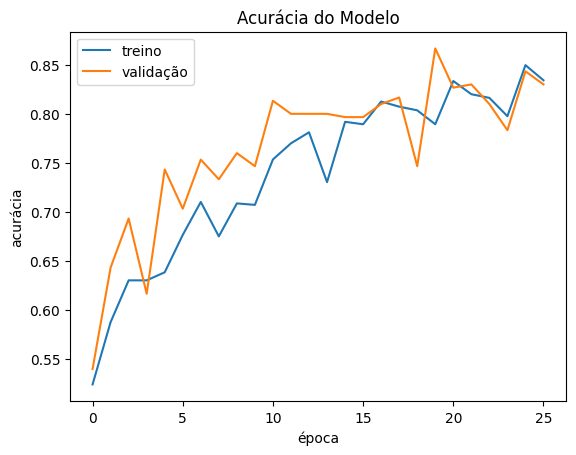

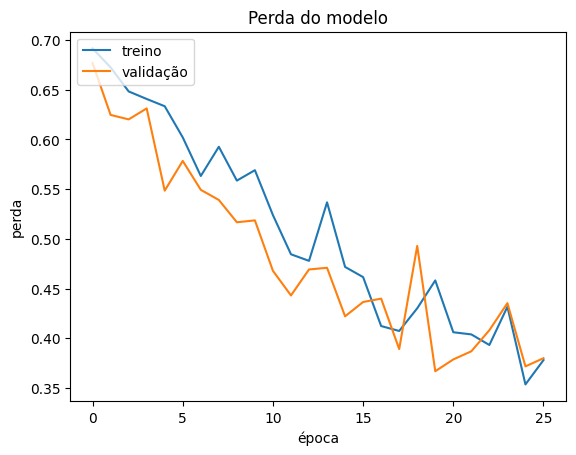

In [ ]:
# lista todos os dados contidos no histórico de treinamento
print(history.history.keys())

# plotamos a acurácia a partir do histórico
plt.plot(history.history['accuracy'])  # acurácia do treinamento
plt.plot(history.history['val_accuracy']) # acurácia na validação (teste)
plt.title('Acurácia do Modelo')
plt.ylabel('acurácia')
plt.xlabel('época')
plt.legend(['treino', 'validação'], loc = 'upper left')
plt.show()

# plotamos o erro/perda a partir do histórico
plt.plot(history.history['loss']) # perda/erro durante o treinamento
plt.plot(history.history['val_loss']) #perda/erro durante a validação (teste)
plt.title('Perda do modelo')
plt.ylabel('perda')
plt.xlabel('época')
plt.legend(['treino', 'validação'], loc = 'upper left')
plt.show()


O modelo treinado foi interrompido após 26 épocas, quando a métrica "*val_loss*" não apresentou mais redução após 6 épocas.

Na última época de treinamento, o modelo alcançou uma Acurácia de 83,4% e Perda de 0.3781 para o conjunto de treino e uma Acurácia de 83% Perda de 0.38 para o conjunto de validação, indicando uma boa capacidade preditiva.

### **5.Execução do modelo treinado em um subconjunto das imagens de teste**

Utilizando o modelo treinado, realizamos uma avaliação em um subconjunto das imagens de teste.

2/2 [==============================] - 1s 119ms/step


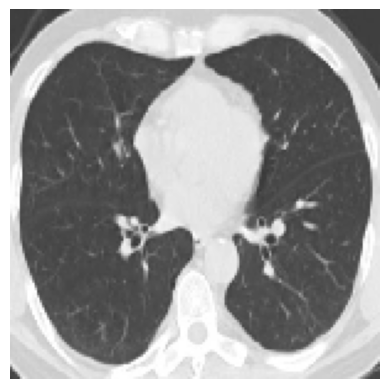

Label:  negativo
Previsão:  negativo
Probabilidade:  0.20563959


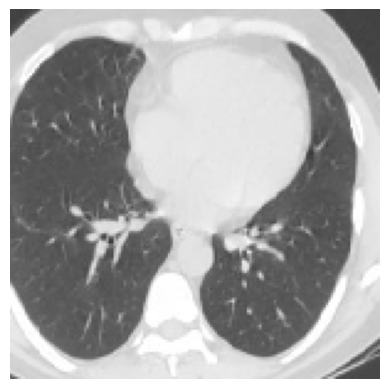

Label:  negativo
Previsão:  negativo
Probabilidade:  0.09314374


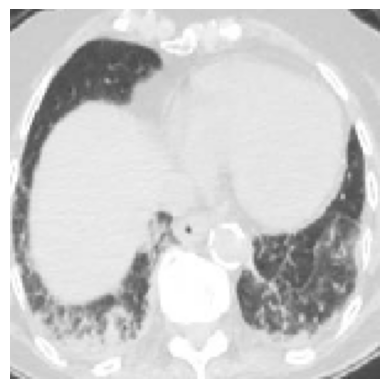

Label:  positivo
Previsão:  positivo
Probabilidade:  0.9565391


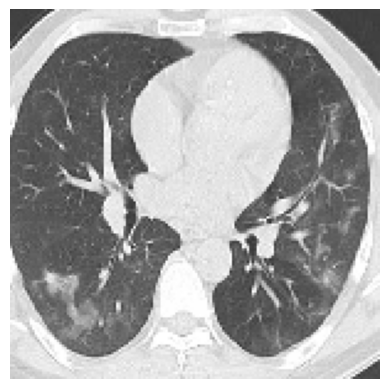

Label:  positivo
Previsão:  positivo
Probabilidade:  0.7987213


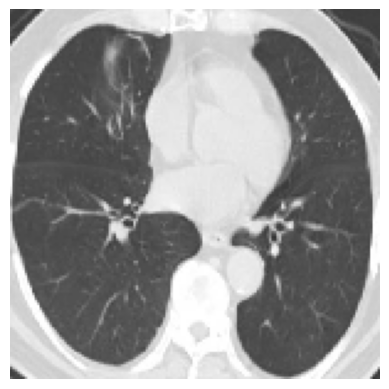

Label:  negativo
Previsão:  negativo
Probabilidade:  0.18364842


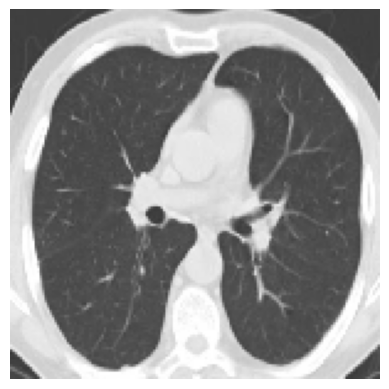

Label:  negativo
Previsão:  negativo
Probabilidade:  0.12913655


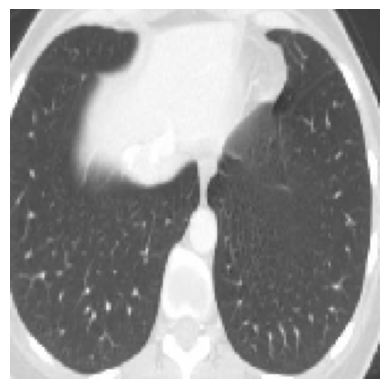

Label:  negativo
Previsão:  negativo
Probabilidade:  0.037168656


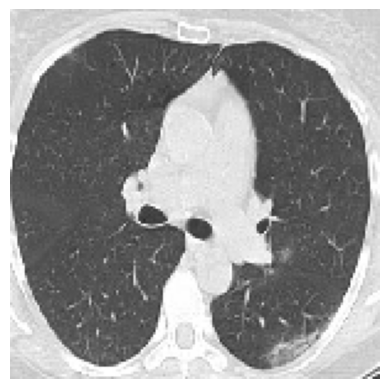

Label:  positivo
Previsão:  positivo
Probabilidade:  0.6957501


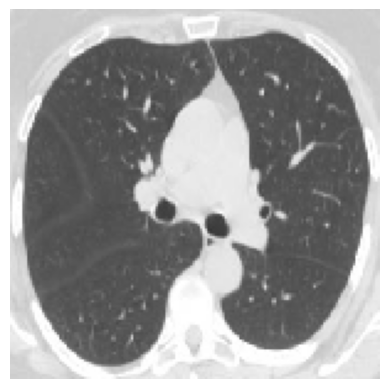

Label:  negativo
Previsão:  negativo
Probabilidade:  0.07071918


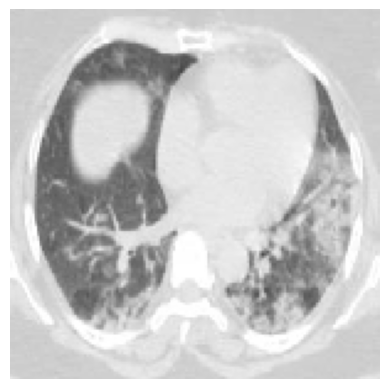

Label:  positivo
Previsão:  positivo
Probabilidade:  0.95845056


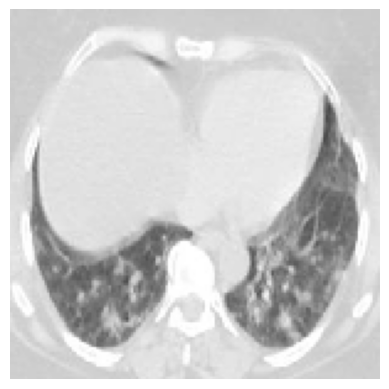

Label:  positivo
Previsão:  positivo
Probabilidade:  0.93095404


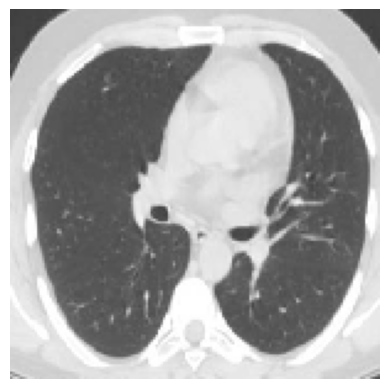

Label:  negativo
Previsão:  negativo
Probabilidade:  0.10544473


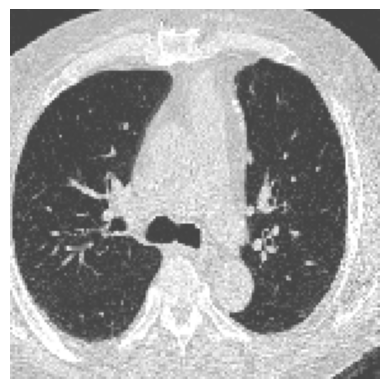

Label:  positivo
Previsão:  positivo
Probabilidade:  0.9990117


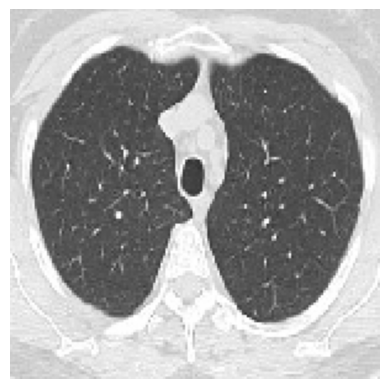

Label:  positivo
Previsão:  negativo
Probabilidade:  0.20205376


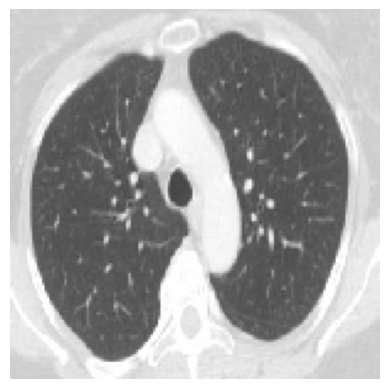

Label:  negativo
Previsão:  negativo
Probabilidade:  0.15315622


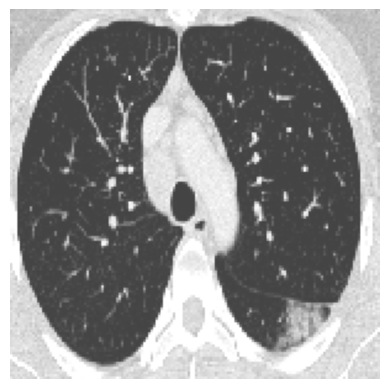

Label:  positivo
Previsão:  positivo
Probabilidade:  0.99972284


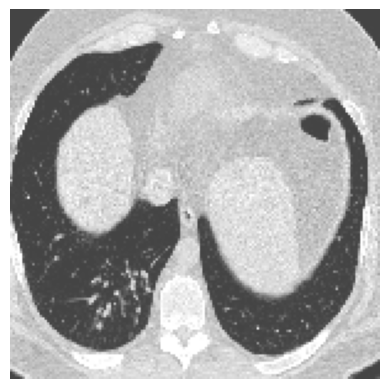

Label:  positivo
Previsão:  positivo
Probabilidade:  0.9835397


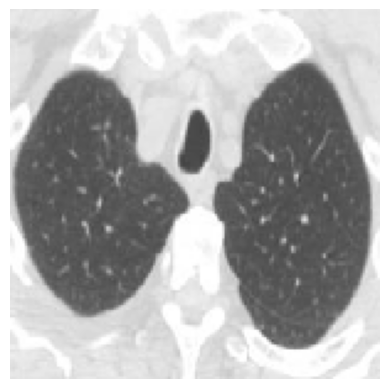

Label:  negativo
Previsão:  negativo
Probabilidade:  0.1751204


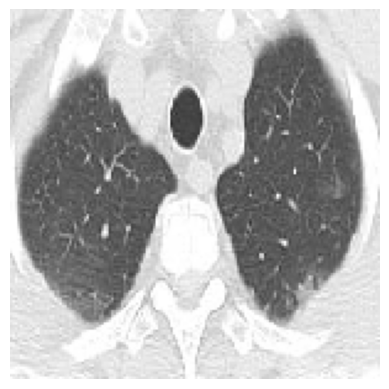

Label:  positivo
Previsão:  negativo
Probabilidade:  0.22446446


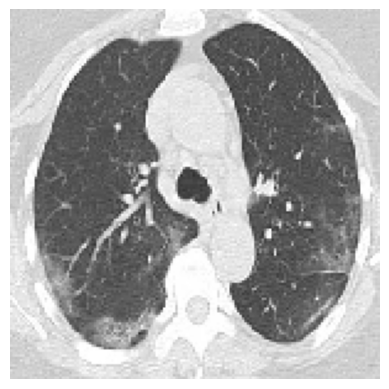

Label:  positivo
Previsão:  positivo
Probabilidade:  0.88804847


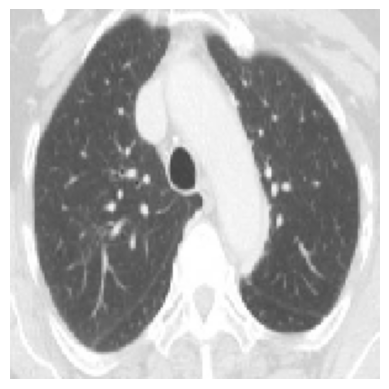

Label:  negativo
Previsão:  negativo
Probabilidade:  0.3805743


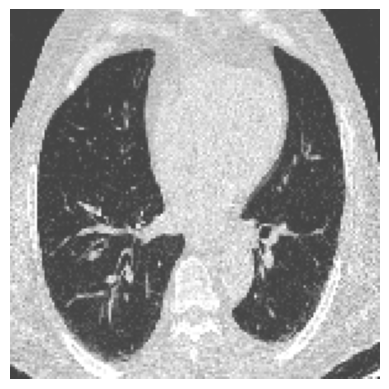

Label:  positivo
Previsão:  positivo
Probabilidade:  0.99809754


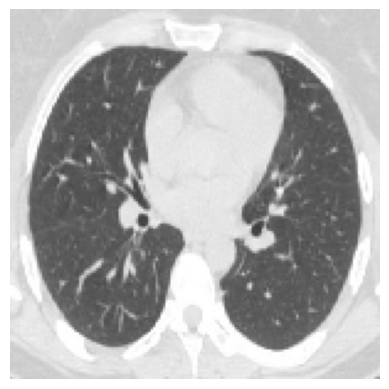

Label:  negativo
Previsão:  positivo
Probabilidade:  0.5414151


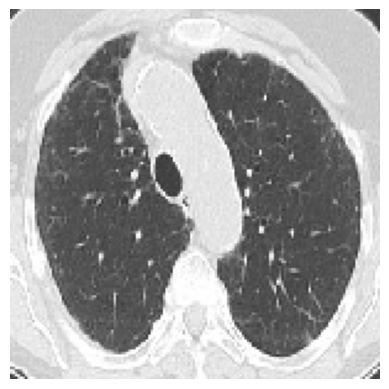

Label:  negativo
Previsão:  positivo
Probabilidade:  0.5910986


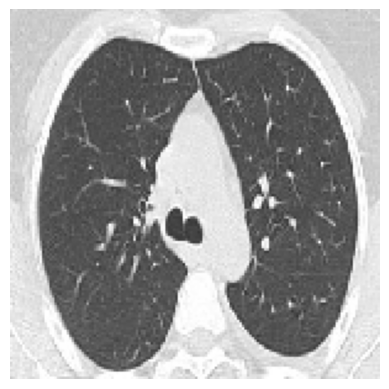

Label:  negativo
Previsão:  positivo
Probabilidade:  0.83151734


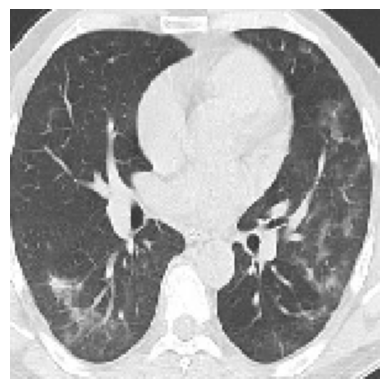

Label:  positivo
Previsão:  positivo
Probabilidade:  0.654097


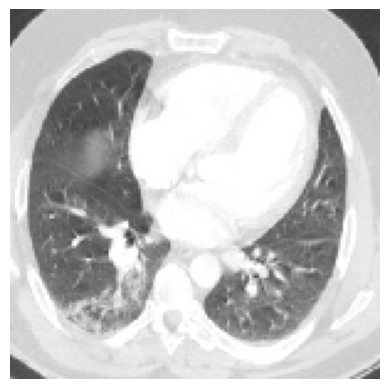

Label:  positivo
Previsão:  positivo
Probabilidade:  0.96852005


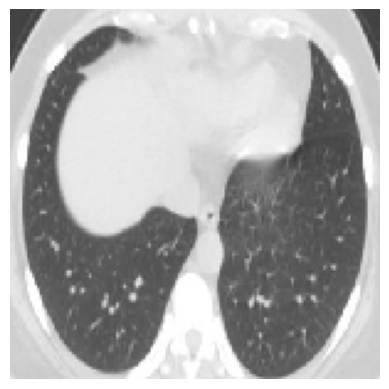

Label:  positivo
Previsão:  negativo
Probabilidade:  0.21531907


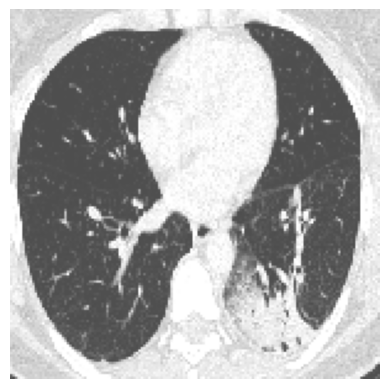

Label:  positivo
Previsão:  positivo
Probabilidade:  0.9826051


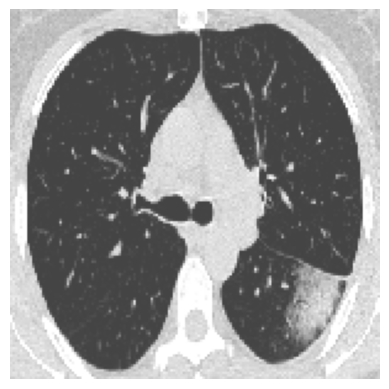

Label:  positivo
Previsão:  positivo
Probabilidade:  0.99996376


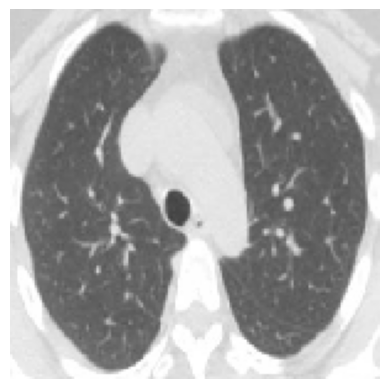

Label:  negativo
Previsão:  negativo
Probabilidade:  0.19345896


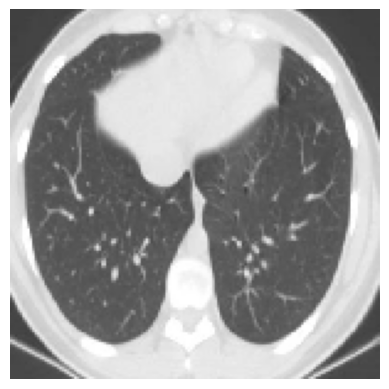

Label:  negativo
Previsão:  negativo
Probabilidade:  0.17647338


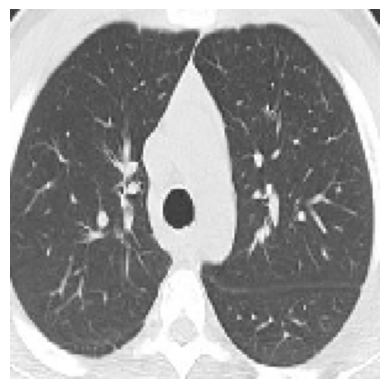

Label:  negativo
Previsão:  negativo
Probabilidade:  0.34072208


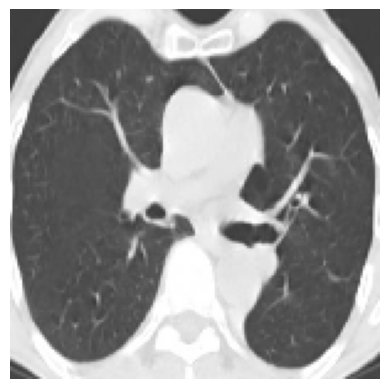

Label:  negativo
Previsão:  negativo
Probabilidade:  0.38982815


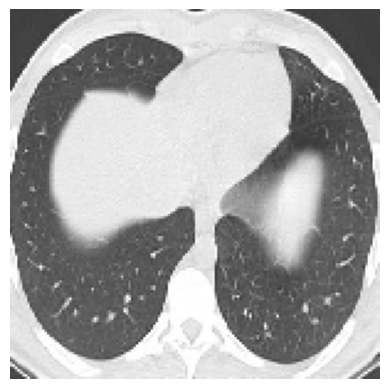

Label:  negativo
Previsão:  negativo
Probabilidade:  0.4586585


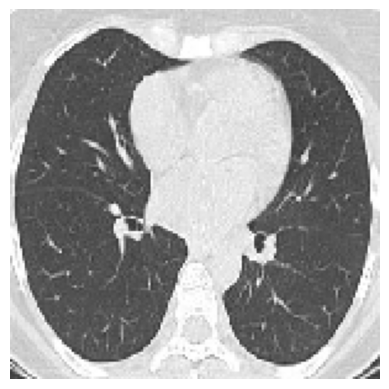

Label:  negativo
Previsão:  positivo
Probabilidade:  0.8987918


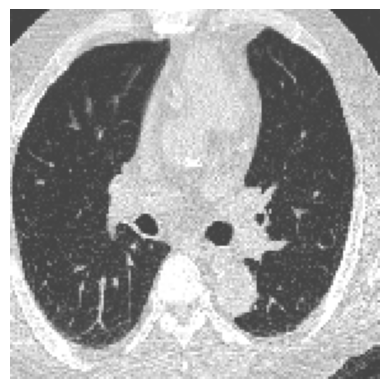

Label:  positivo
Previsão:  positivo
Probabilidade:  0.99901706


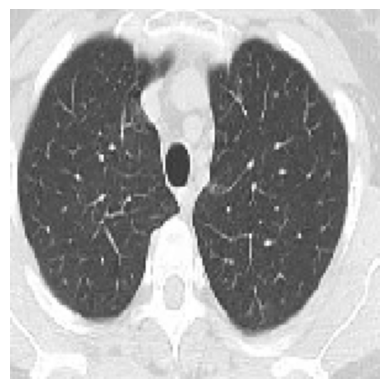

Label:  positivo
Previsão:  negativo
Probabilidade:  0.11734542


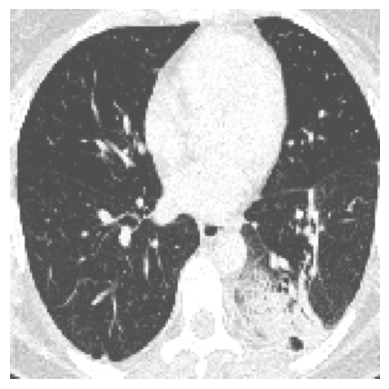

Label:  positivo
Previsão:  positivo
Probabilidade:  0.5864384


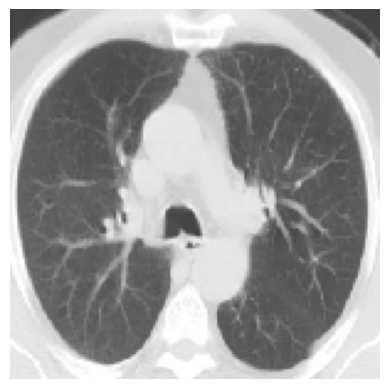

Label:  negativo
Previsão:  negativo
Probabilidade:  0.34883386


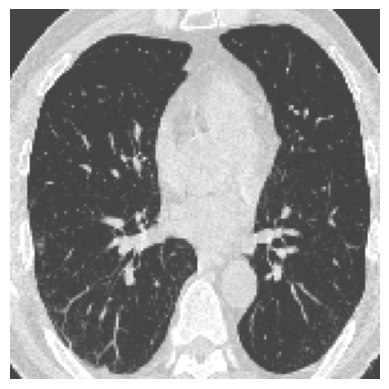

Label:  positivo
Previsão:  positivo
Probabilidade:  0.9999421


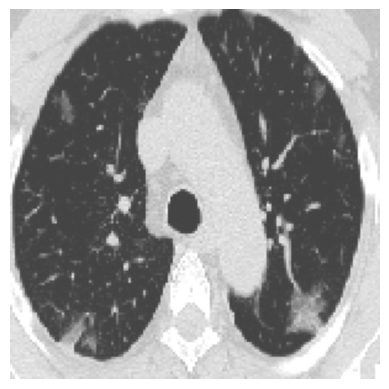

Label:  positivo
Previsão:  positivo
Probabilidade:  0.9998569


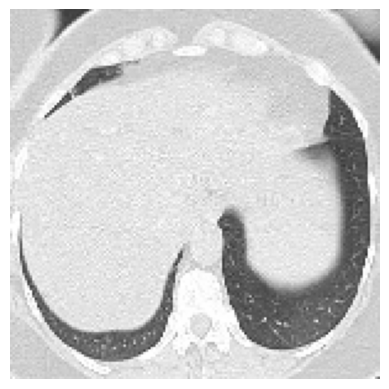

Label:  positivo
Previsão:  positivo
Probabilidade:  0.89124


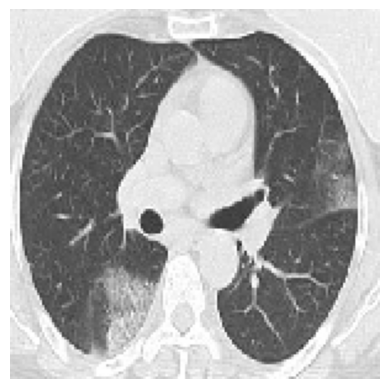

Label:  positivo
Previsão:  positivo
Probabilidade:  0.9833072


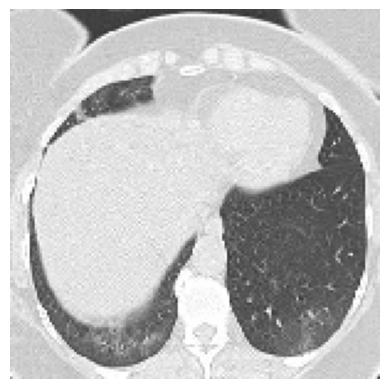

Label:  positivo
Previsão:  positivo
Probabilidade:  0.59453785


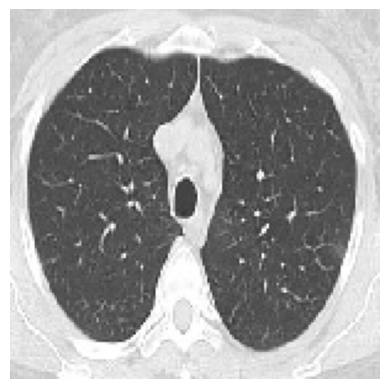

Label:  positivo
Previsão:  negativo
Probabilidade:  0.38385832


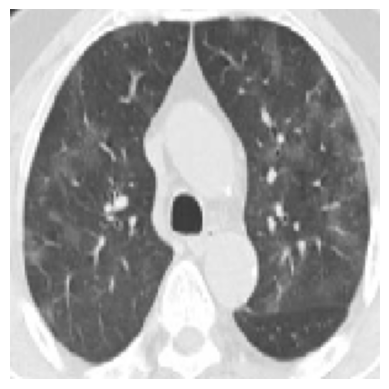

Label:  positivo
Previsão:  positivo
Probabilidade:  0.6980827


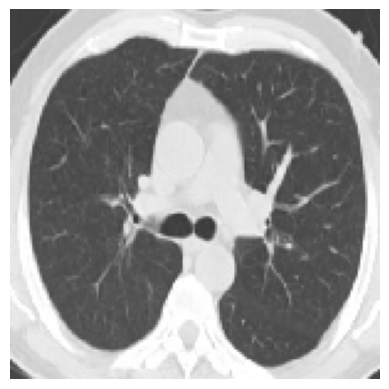

Label:  negativo
Previsão:  negativo
Probabilidade:  0.15980192


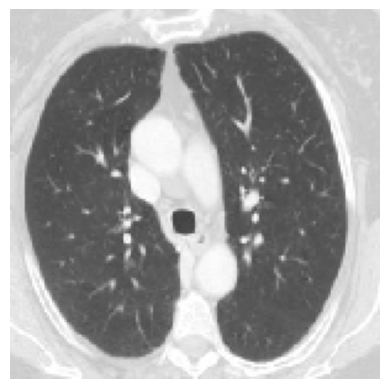

Label:  negativo
Previsão:  negativo
Probabilidade:  0.13459532


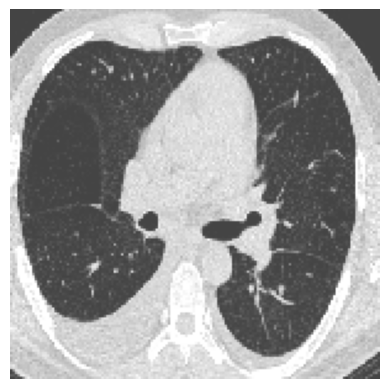

Label:  positivo
Previsão:  positivo
Probabilidade:  0.9965037


In [ ]:
# variávies
count = 0
y_pred = list()
y_true = list()
class_names = ['negativo', 'positivo']

# Loop do data generator de teste que contem as imagens
for batch in test_generator:

    count+=1

    # Condição de saída do loop. Só executaremos o modelo em algumas imagens
    if count == 2:
        break

    else:

        # Pegando a imagem e o label
        images = batch[0]
        labels = batch[1]

        # Previsão
        predictions = model.predict(images)

        # Visualização da imagem
        for i in range(len(images)):

            image = images[i]
            label = labels[i]
            prediction = predictions[i]

            # Converte o array de previsão para visualizar a classe e a probabilidade
            predicted_class = np.argmax(prediction)
            probability = prediction[predicted_class]
            label = class_names[int(label)]
            y_true.append(label)

            # Faz o DE-PARA da probabilidade com o tipo de classe da previsão
            class_name = 'positivo' if prediction >= 0.5 else 'negativo'
            y_pred.append(class_name)

            # Configura a saída das imagens que serão visualizadas
            plt.imshow(images[i])
            plt.axis('Off')
            plt.show()

            # Imprime os resultados da classificação das images
            print("Label: ", label)
            print("Previsão: ", class_name)
            print("Probabilidade: ", probability)

### **6.Avaliação do modelo de deep learning**

In [ ]:
# Imprimindo a acurácia e a perda do modelo
loss, accuracy = model.evaluate(test_generator)
print("Resultados na conjunto de teste: acurácia = %f  ;  loss = %f " % (accuracy, loss))

15/15 [==============================] - 10s 575ms/step - loss: 0.4494 - accuracy: 0.8148
Resultados na conjunto de teste: acurácia = 0.814765  ;  loss = 0.449440 


Quando o modelo foi submetido ao conjunto de teste, apresentou níveis semelhantes de Acurácia e Perda, com 81,47% e 0.44944, respectivamnte.

Os resultados encontrados no conjunto de teste mostraram coerência com os resultados encontrados no conjunto de treinamento e na base de validação, indicando que o modelo manteve níveis semelhantes de acertos quando utilizado em imagens nunca vistas anteriormente.

#### Visualização de métricas da avaliação do modelo

Métricas de performance do modelo no subconjunto das imagens de teste.

In [ ]:
accuracy = skm.accuracy_score(y_true, y_pred)
precision = skm.precision_score(y_true, y_pred, average = 'binary', pos_label = 'positivo')
recall = skm.recall_score(y_true, y_pred, average = 'binary', pos_label = 'positivo')
f1score = skm.f1_score(y_true, y_pred, average = 'binary', pos_label = 'positivo')

print("Acurácia: ", accuracy)
print("Precisão: ", precision)
print("Recall: ", recall)
print("F1 Score: ", f1score)

Acurácia:  0.82
Precisão:  0.8518518518518519
Recall:  0.8214285714285714
F1 Score:  0.8363636363636364


Matriz de confusão do modelo de deep learning no subconjunto de imagens de teste, identificando acertos e erros do modelo nesta amostra.

Matriz de confusão sem normalização


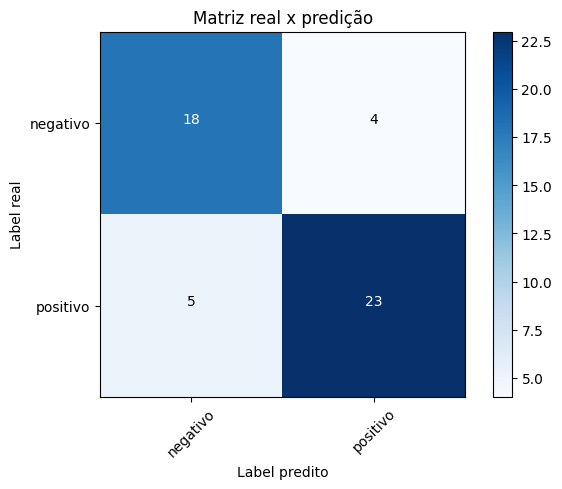

In [ ]:
cnf_matrix = confusion_matrix(y_true, y_pred, labels = class_names)
np.set_printoptions(precision = 2)

plt.figure()
plot_confusion_matrix(cnf_matrix,
                      classes = ['negativo', 'positivo'],
                      normalize = False,
                      title ='Matriz real x predição')

### **7.Conclusão**

Avaliando os resultados encontrados, o modelo construído apresentou um bom nível de **acurácia** tanto no conjunto de treino e validação quanto no conjunto de imagens de teste, com **níveis de acurácia acima de 80%**, indicando que o erro geral do modelo se mostrou estável também em um conjunto de imagens desconhecido.

Em relação à classe de interesse, a **Precisão**, que avalia a razão entre o número de predições verdadeiras positivas e a quantidade total de predições positivas, **foi de 85,18%** e o **Recall**, que avalia o número de predições verdadeiras positivas e a quantidade total de exemplos positivos no conjunto de dados, **foi de 82,14%**, indicando que modelo também foi capaz de ter bons resultados para a classe alvo. Além disso, o modelo também apresentou um bom resultado para a métrica **F1-Score**, de **83,63%**, demonstrando ter uma boa qualidade geral.

Os resultados encontrados sugerem que modelo pode ser utilizado para auxiliar no diagnóstico médico de infecção pelo vírus do SARS-CoV-2 com bom nível de acerto, podendo ser colocado em produção.

Vale ressaltar que o conjunto de dados utilizado é relativamente pequeno, com apenas 2.481 imagens, e que por essa razão não pode ser utilizado de forma isolada no diagnóstico da infecção, sendo necessários q sejam realizados aprimoramentos na arquitetura da rede e teste com um conjunto de dados maior para aprimorar os níveis de acerto, tanto para a classe de interesse quando para a ausência da infecção.

### **8.Exportação do modelo de deep learning para posterior uso**

Salvando o modelo de deep learning que foi treinado.

In [ ]:
# obtendo a data e hora atual
now = datetime.now()

# Definição do formato
format = '%Y-%m-%dT%H%M'

# Converter a data e hora em uma string com o formato especificado
formatted_datetime = now.strftime(format)

path_model = 'Modelo/Modelo_treinado'

name_model = 'trained_model_' + formatted_datetime + '.h5'

# salvando o modelo
model.save("%s/%s" % (path_model, name_model))
print("Modelo salvo com o nome: ", name_model)

Modelo salvo com o nome:  trained_model_2023-07-23T0135.h5


### **9.Teste do modelo exportado**
Carregando o modelo salvo para teste.

In [ ]:
loaded_model = keras.models.load_model("%s/%s" % (path_model, name_model))
print("Modelo %s carregado com sucesso" % (name_model))

Modelo trained_model_2023-07-23T0135.h5 carregado com sucesso


Execução do modelo em um subconjunto de imagens de teste

2/2 [==============================] - 0s 122ms/step


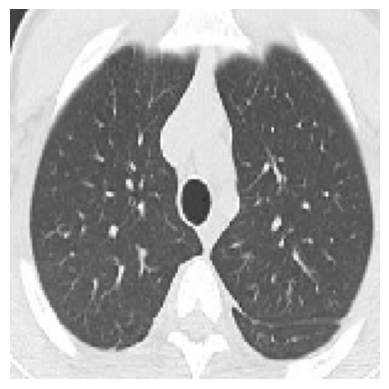

Label:  negativo
Previsão:  negativo
Probabilidade:  0.09926322


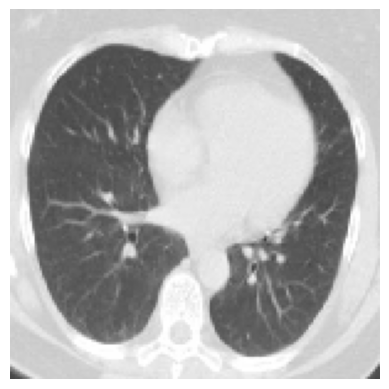

Label:  negativo
Previsão:  negativo
Probabilidade:  0.28979832


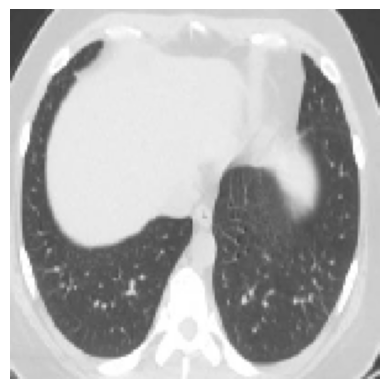

Label:  positivo
Previsão:  negativo
Probabilidade:  0.3386797


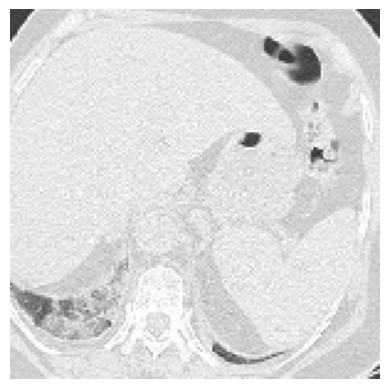

Label:  positivo
Previsão:  positivo
Probabilidade:  0.9530287


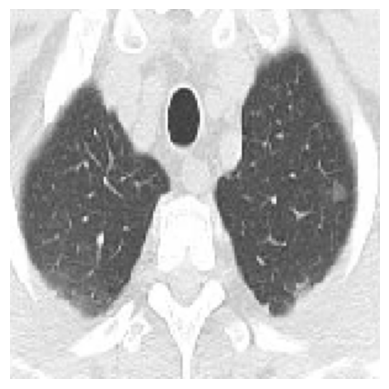

Label:  positivo
Previsão:  negativo
Probabilidade:  0.28581017


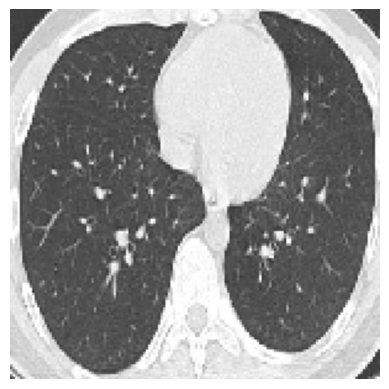

Label:  negativo
Previsão:  positivo
Probabilidade:  0.6677293


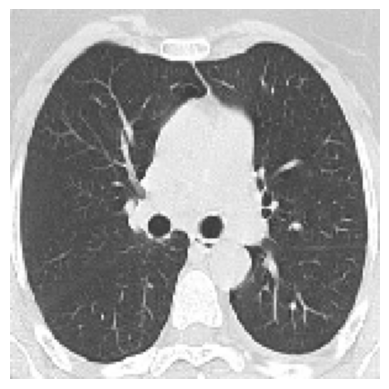

Label:  negativo
Previsão:  negativo
Probabilidade:  0.4362866


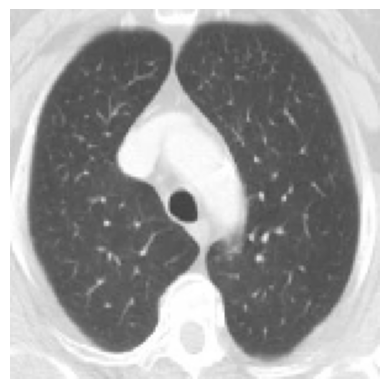

Label:  negativo
Previsão:  negativo
Probabilidade:  0.07848335


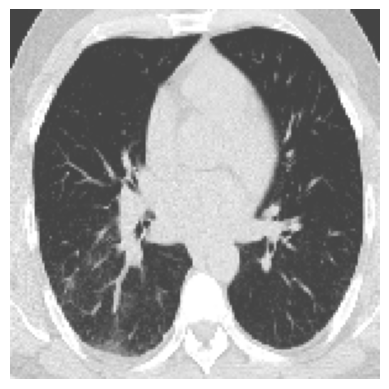

Label:  positivo
Previsão:  positivo
Probabilidade:  0.99869037


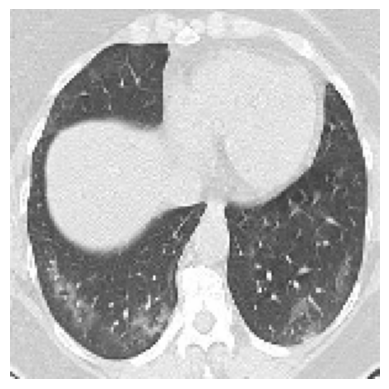

Label:  positivo
Previsão:  positivo
Probabilidade:  0.6269938


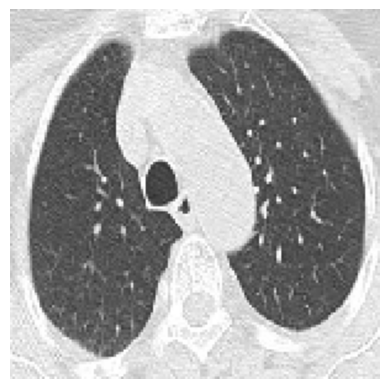

Label:  negativo
Previsão:  positivo
Probabilidade:  0.5180876


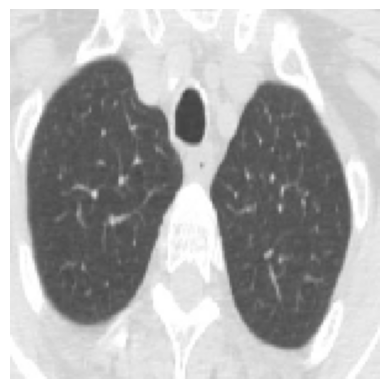

Label:  negativo
Previsão:  negativo
Probabilidade:  0.14229065


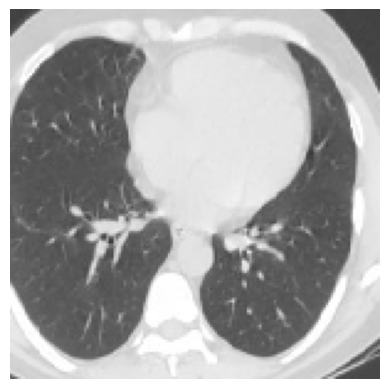

Label:  negativo
Previsão:  negativo
Probabilidade:  0.09314374


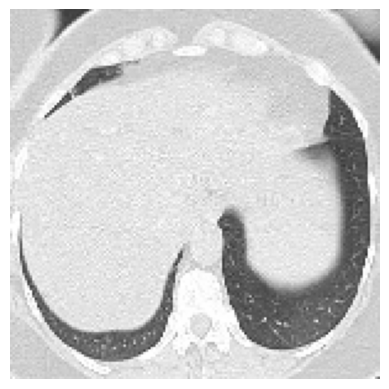

Label:  positivo
Previsão:  positivo
Probabilidade:  0.89124


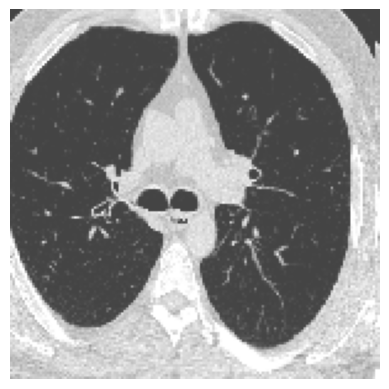

Label:  positivo
Previsão:  positivo
Probabilidade:  0.9994429


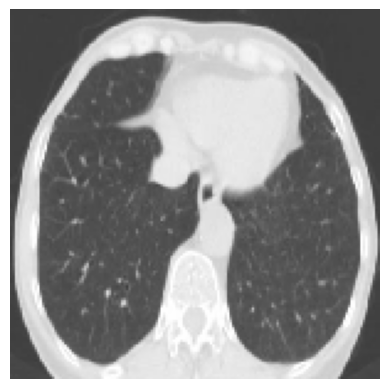

Label:  negativo
Previsão:  negativo
Probabilidade:  0.060986914


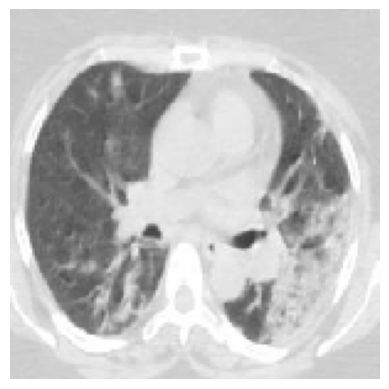

Label:  positivo
Previsão:  positivo
Probabilidade:  0.8406951


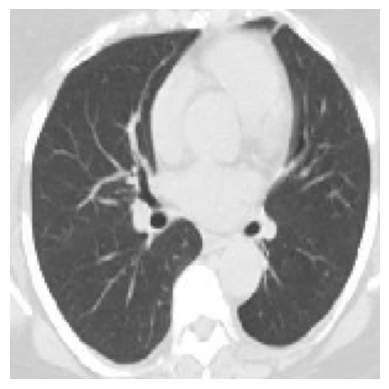

Label:  negativo
Previsão:  negativo
Probabilidade:  0.3446623


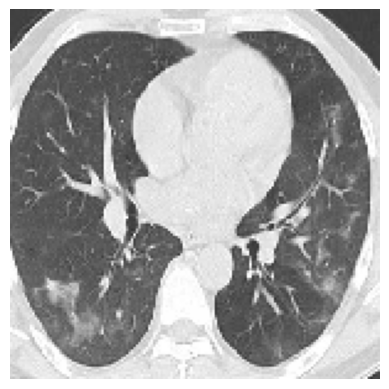

Label:  positivo
Previsão:  positivo
Probabilidade:  0.7903627


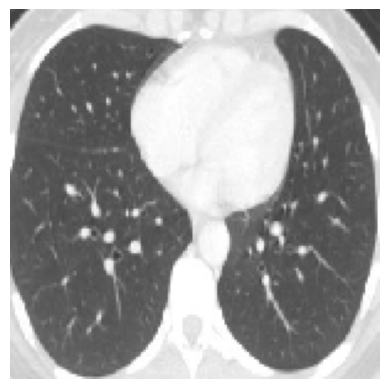

Label:  negativo
Previsão:  negativo
Probabilidade:  0.1288032


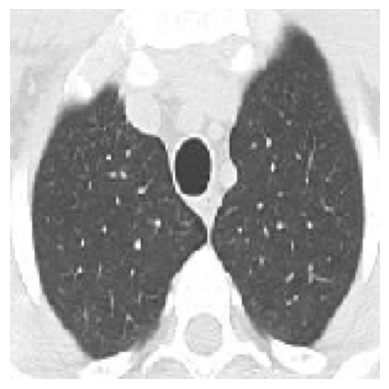

Label:  negativo
Previsão:  negativo
Probabilidade:  0.035907988


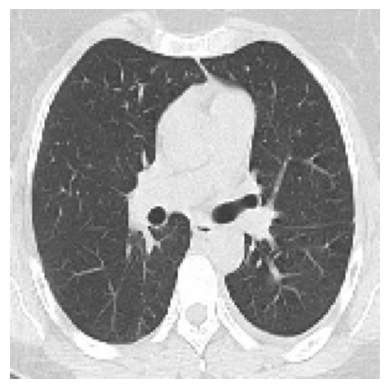

Label:  negativo
Previsão:  positivo
Probabilidade:  0.7544997


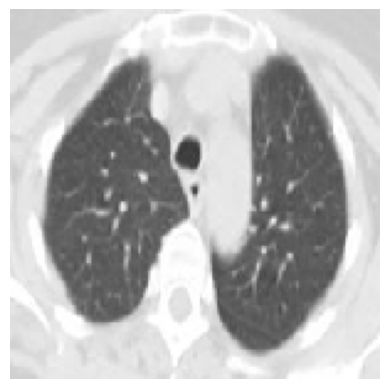

Label:  negativo
Previsão:  negativo
Probabilidade:  0.2766762


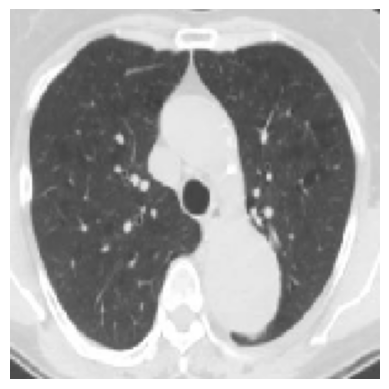

Label:  negativo
Previsão:  positivo
Probabilidade:  0.5804317


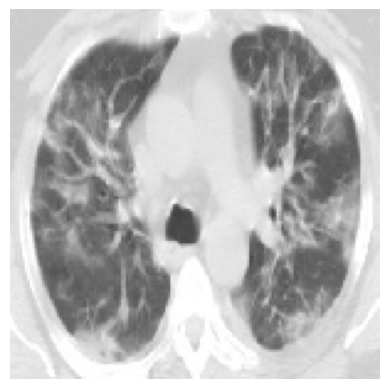

Label:  positivo
Previsão:  positivo
Probabilidade:  0.9176515


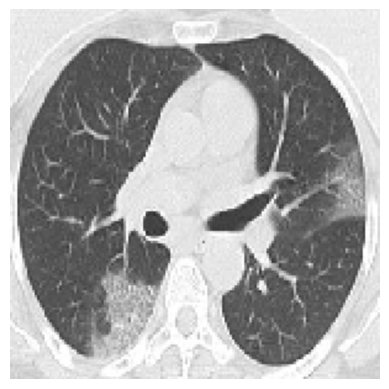

Label:  positivo
Previsão:  positivo
Probabilidade:  0.98917097


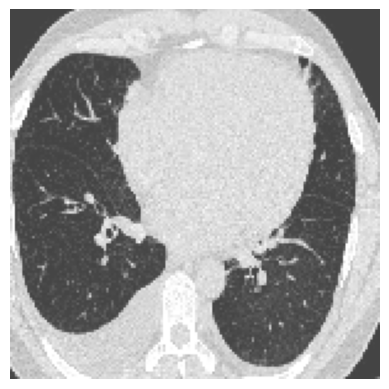

Label:  positivo
Previsão:  positivo
Probabilidade:  0.9957961


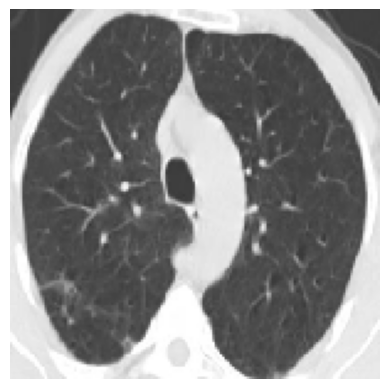

Label:  negativo
Previsão:  negativo
Probabilidade:  0.41308153


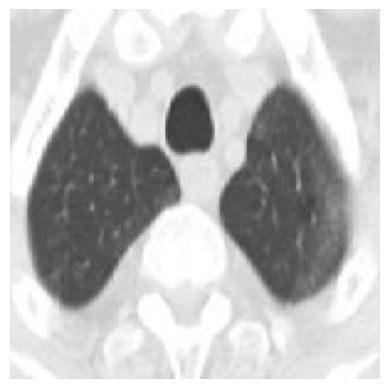

Label:  positivo
Previsão:  negativo
Probabilidade:  0.16392075


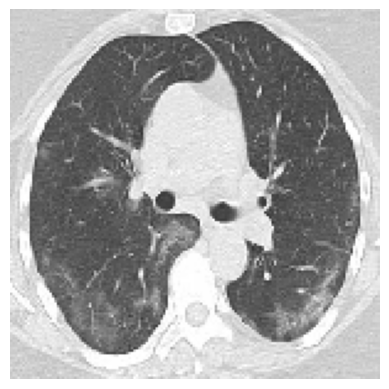

Label:  positivo
Previsão:  positivo
Probabilidade:  0.8835974


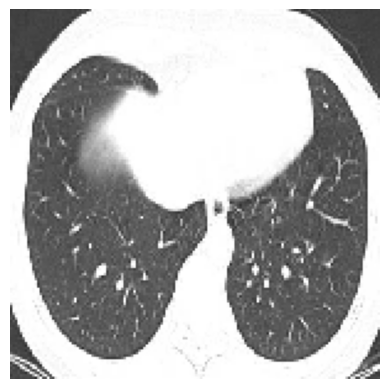

Label:  negativo
Previsão:  positivo
Probabilidade:  0.78842473


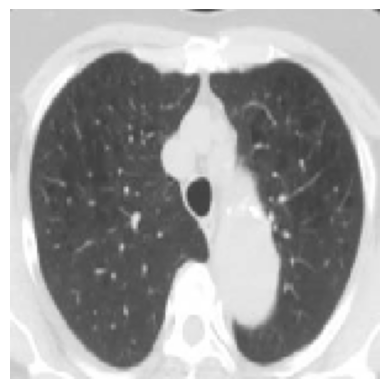

Label:  negativo
Previsão:  positivo
Probabilidade:  0.559982


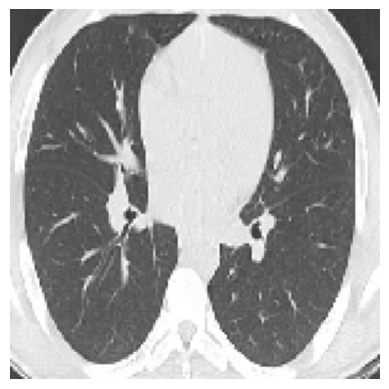

Label:  negativo
Previsão:  positivo
Probabilidade:  0.5778956


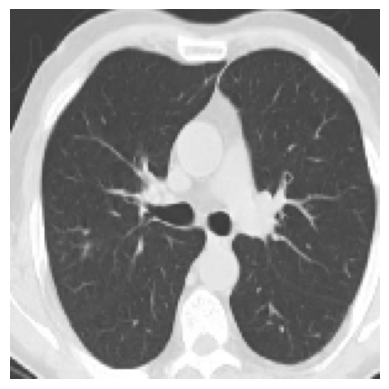

Label:  negativo
Previsão:  negativo
Probabilidade:  0.12842691


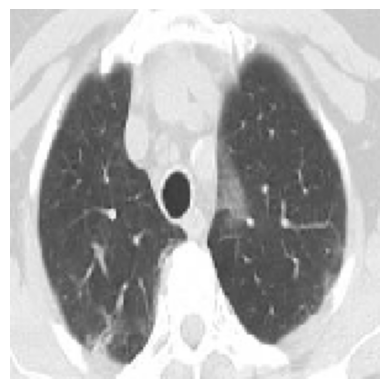

Label:  positivo
Previsão:  negativo
Probabilidade:  0.11921562


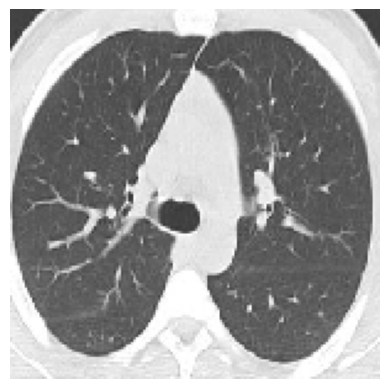

Label:  negativo
Previsão:  positivo
Probabilidade:  0.62297463


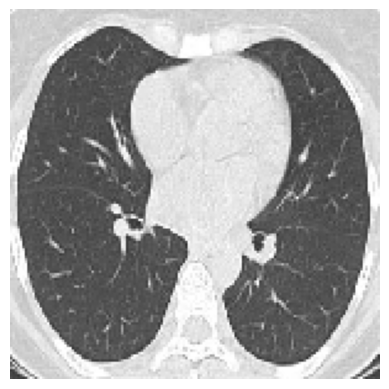

Label:  negativo
Previsão:  positivo
Probabilidade:  0.90235704


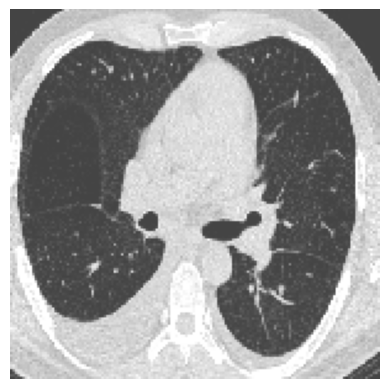

Label:  positivo
Previsão:  positivo
Probabilidade:  0.9965037


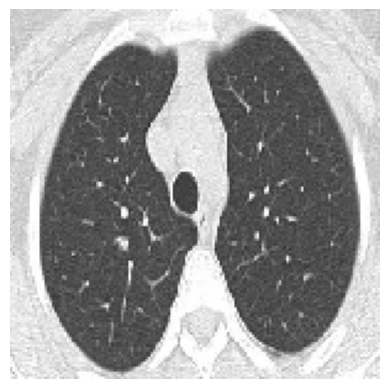

Label:  negativo
Previsão:  negativo
Probabilidade:  0.046003036


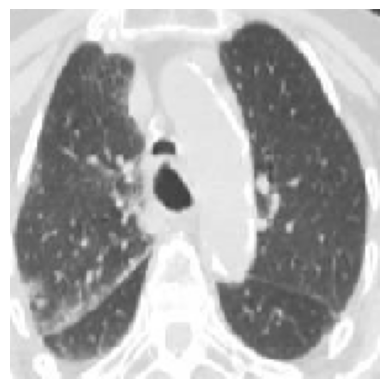

Label:  positivo
Previsão:  positivo
Probabilidade:  0.79764676


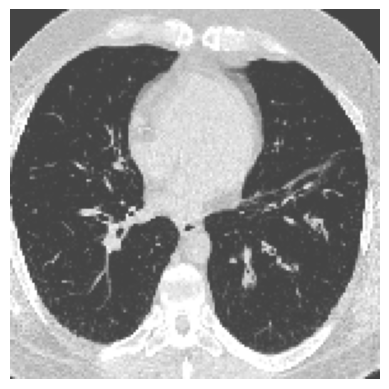

Label:  positivo
Previsão:  positivo
Probabilidade:  0.9945529


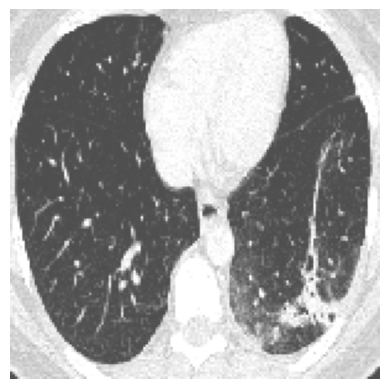

Label:  positivo
Previsão:  positivo
Probabilidade:  0.90838164


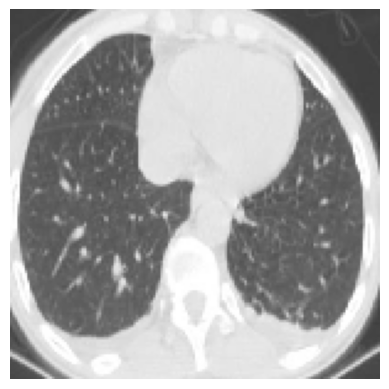

Label:  negativo
Previsão:  negativo
Probabilidade:  0.27807632


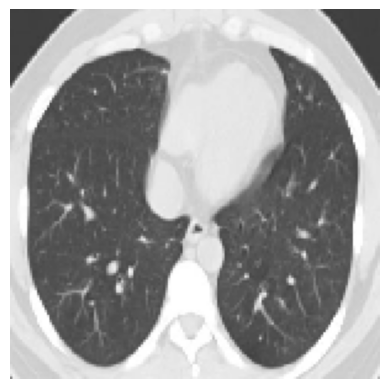

Label:  negativo
Previsão:  positivo
Probabilidade:  0.6665594


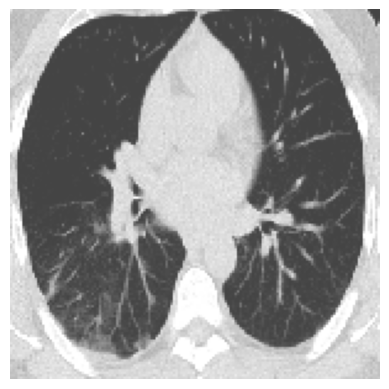

Label:  positivo
Previsão:  positivo
Probabilidade:  0.998062


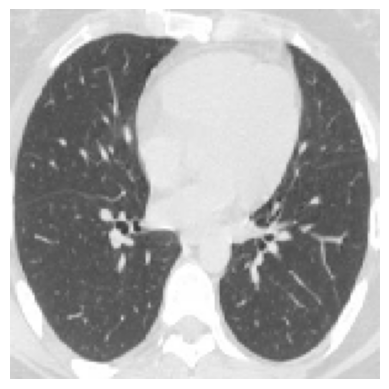

Label:  negativo
Previsão:  negativo
Probabilidade:  0.120667666


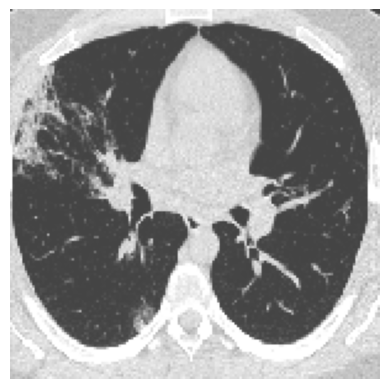

Label:  positivo
Previsão:  positivo
Probabilidade:  0.9909232


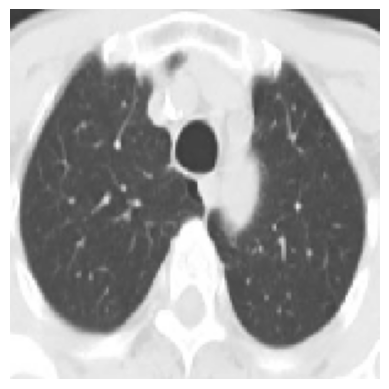

Label:  negativo
Previsão:  negativo
Probabilidade:  0.05299242


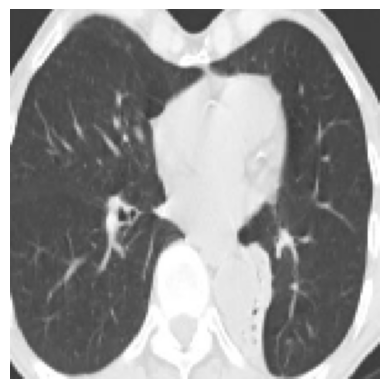

Label:  negativo
Previsão:  positivo
Probabilidade:  0.7337182


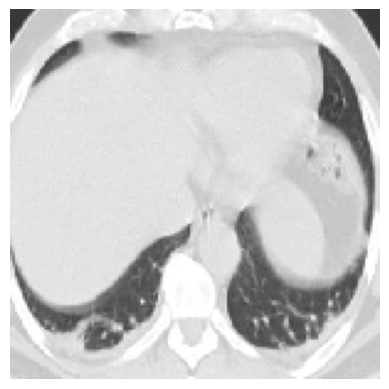

Label:  positivo
Previsão:  positivo
Probabilidade:  0.8589788


In [ ]:
# Declaração das variávies
count = 0
y_pred = list()
y_true = list()
class_names = ['negativo', 'positivo']

# Loop do data generator de teste que contem as imagens
for batch in test_generator:

    count+=1

    # Condição de saída do loop. Só executaremos o modelo em algumas imagens
    if count == 2:
        break

    else:

        # Pegando a imagem e o label
        images = batch[0]
        labels = batch[1]

        # Previsão
        predictions = loaded_model.predict(images)

        # Visualização da imagem
        for i in range(len(images)):

            image = images[i]
            label = labels[i]
            prediction = predictions[i]

            # Converte o array de previsão para visualizar a classe e a probabilidade
            predicted_class = np.argmax(prediction)
            probability = prediction[predicted_class]
            label = class_names[int(label)]
            y_true.append(label)

            # Faz o DE-PARA da probabilidade com o tipo de classe da previsão
            class_name = 'positivo' if prediction >= 0.5 else 'negativo'
            y_pred.append(class_name)

            # Configura a saída das imagens que serão visualizadas
            plt.imshow(images[i])
            plt.axis('Off')
            plt.show()

            # Imprime os resultados da classificação das images
            print("Label: ", label)
            print("Previsão: ", class_name)
            print("Probabilidade: ", probability)

Concluíndo, o modelo apresentou bom funcionamento após ser exportado, armazenado e importado novamente para uso.